## load pkgs

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt

In [2]:
sc.set_figure_params(dpi=120, dpi_save=300, vector_friendly=False, figsize=(4,4))
sc.settings.verbosity = 1
sc.logging.print_header()

%matplotlib inline 

scanpy==1.9.6 anndata==0.10.3 umap==0.5.5 numpy==1.23.5 scipy==1.9.1 pandas==2.1.1 scikit-learn==1.3.2 statsmodels==0.14.0 igraph==0.10.4 pynndescent==0.5.11


## plot setting

In [ ]:
%run ./py_script/marker.py

In [ ]:
%run ./py_script/colorconfig.py

## workpath

In [19]:
# tumor
workdir = '/home/zhepan/Project/MultiOmics/data/tumor/scRNA/Object/'
sample_list = ['P1013S2','P1015S2','P1018S1','P1019S2','P1020S1','P1023S2','P1024S1','P1024S2']
resdir = '/home/zhepan/Project/MultiOmics/data/tumor/scRNA/Object/summary/'

In [3]:
# skin
workdir = '/home/zhepan/Project/MultiOmics/data/skin/'
sample_list = ['SKIN-A1002','SKIN-B1002','SKIN-A1007','SKIN-B1007','SKIN-A1009','SKIN-B1009']
resdir = '/home/zhepan/Project/MultiOmics/data/skin/res'

In [5]:
# vas

workdir = '/home/zhepan/Project/MultiOmics/data/vasce/'
sample_list = 'P1020N'


In [117]:
filtertype = 'cellranger'

## process

In [ ]:
adata = sc.read_10x_mtx(workdir+sample_list, var_names='gene_symbols')


In [7]:
adata

AnnData object with n_obs × n_vars = 2799 × 33694
    var: 'gene_ids', 'feature_types'

In [113]:
adatas = [sc.read_h5ad(workdir+sample+'/raw/'+filtertype+'_doublet.h5ad') for sample in sample_list]

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '/home/zhepan/Project/MultiOmics/data/tumor/scRNA/Object/P1013S2/raw/decontx_doublet.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [114]:
for index, adata in enumerate(adatas):
    adatas[index].obs_names = [sample_list[index]+'-'+ obs_name[0:16] for obs_name in adatas[index].obs_names]

In [ ]:
adata = ad.concat([adatas[index] for index,adata in enumerate(adatas)], uns_merge='same', join='outer')
adata

AnnData object with n_obs × n_vars = 78257 × 29703
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb'

In [ ]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,PatientID,NeoChemoRes,NeoRadRes,SampleID,SampleTimepoint,SampleMethod,SampleDate,Kit,scDblFinder.score,scDblFinder.class,percent_mt,percent_hb,S.Score,G2M.Score,Phase,percent_rb
P1013S2-AAACCTGAGAATTGTG,P1013S2,2849.0,1680,P1013,PCR,PCR,P1013S2,S2,surgery,20231102,sc5,0.003814,singlet,4.352404,0.000000,0.068854,-0.026930,S,NaN
P1013S2-AAACCTGAGCGATAGC,P1013S2,2355.0,1319,P1013,PCR,PCR,P1013S2,S2,surgery,20231102,sc5,0.000138,singlet,1.104034,0.000000,-0.058762,0.023214,G2M,NaN
P1013S2-AAACCTGAGCGCTTAT,P1013S2,2124.0,1342,P1013,PCR,PCR,P1013S2,S2,surgery,20231102,sc5,0.000098,singlet,7.580038,0.000000,-0.082566,-0.039214,G1,NaN
P1013S2-AAACCTGAGCGTCTAT,P1013S2,4421.0,1702,P1013,PCR,PCR,P1013S2,S2,surgery,20231102,sc5,0.003033,singlet,1.492875,0.000000,-0.025413,-0.038280,G1,NaN
P1013S2-AAACCTGAGTACTTGC,P1013S2,9980.0,3721,P1013,PCR,PCR,P1013S2,S2,surgery,20231102,sc5,0.023805,singlet,2.104208,0.000000,0.005813,-0.033792,S,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
P1024S2-TTTGTCACATAGAAAC,P1024S2,10738.0,3542,P1024,NaN,NaN,P1024S2,S2,surgery,NaN,sc5,0.002051,singlet,2.374744,0.000000,0.005493,-0.056181,S,11.734029
P1024S2-TTTGTCATCCGAGCCA,P1024S2,11283.0,3599,P1024,NaN,NaN,P1024S2,S2,surgery,NaN,sc5,0.144233,singlet,1.196490,0.026589,0.050041,0.031293,S,13.143667
P1024S2-TTTGTCATCGCGGATC,P1024S2,1494.0,978,P1024,NaN,NaN,P1024S2,S2,surgery,NaN,sc5,0.000068,singlet,4.886212,0.000000,-0.063481,-0.050027,G1,6.492637
P1024S2-TTTGTCATCTCCAACC,P1024S2,10411.0,3646,P1024,NaN,NaN,P1024S2,S2,surgery,NaN,sc5,0.628357,doublet,4.187878,0.009605,0.029454,0.030993,G2M,11.545481


In [110]:
adata.obs['SampleID'].value_counts()

SampleID
P1018S1    19252
P1013S2    11573
P1024S1     7995
P1015S2     7959
P1019S2     5233
P1024S2     4909
P1020S1     3552
P1023S2     2755
Name: count, dtype: int64

In [28]:
adata.write_h5ad(resdir+filtertype+'_raw.h5ad')

In [73]:
adata = sc.read_h5ad(resdir+filtertype+'_raw.h5ad')

In [74]:
mt_gene = adata.var_names[adata.var_names.str.startswith('MT-')]
hb_gene = adata.var_names[adata.var_names.str.contains('^HB[^P]')]
rp_gene = adata.var_names[adata.var_names.str.startswith(('RPS','RPL'))]
cc_gene = pd.read_table('/home/zhepan/Reference/regev_lab_cell_cycle_genes.txt',header=None)[0]

In [75]:
remove_gene = np.concatenate([hb_gene], axis = None)
remove_gene

array(['HBA1', 'HBA2', 'HBB', 'HBD', 'HBEGF', 'HBG1', 'HBG2', 'HBM',
       'HBQ1', 'HBS1L', 'HBZ'], dtype=object)

In [76]:
adata = adata[:,adata.var_names.isin(remove_gene) == False]

In [77]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:139: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


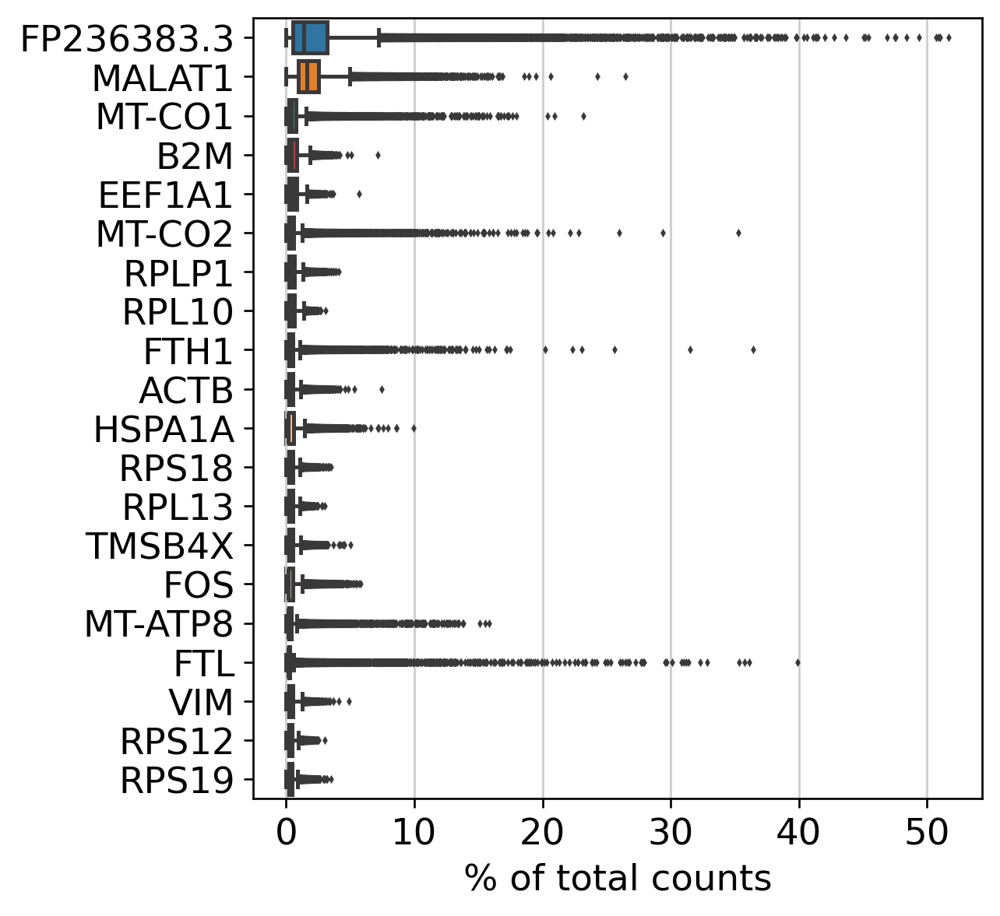

In [78]:
%%capture --no-display
sc.pl.highest_expr_genes(adata, n_top=20)

In [80]:
adata

AnnData object with n_obs × n_vars = 78228 × 29692
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes'
    var: 'n_cells'
    uns: 'SampleID_colors'

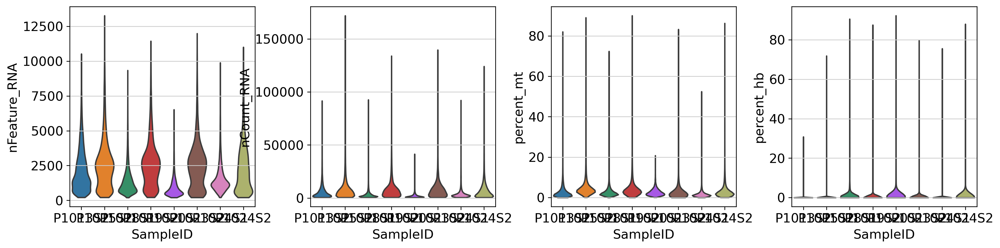

In [79]:
%%capture --no-display
sc.pl.violin(adata, [
    'nFeature_RNA',
    'nCount_RNA', 
    'percent_mt',
    'percent_hb',
    ],groupby='SampleID',
    jitter=0.4, multi_panel=True,stripplot=False)

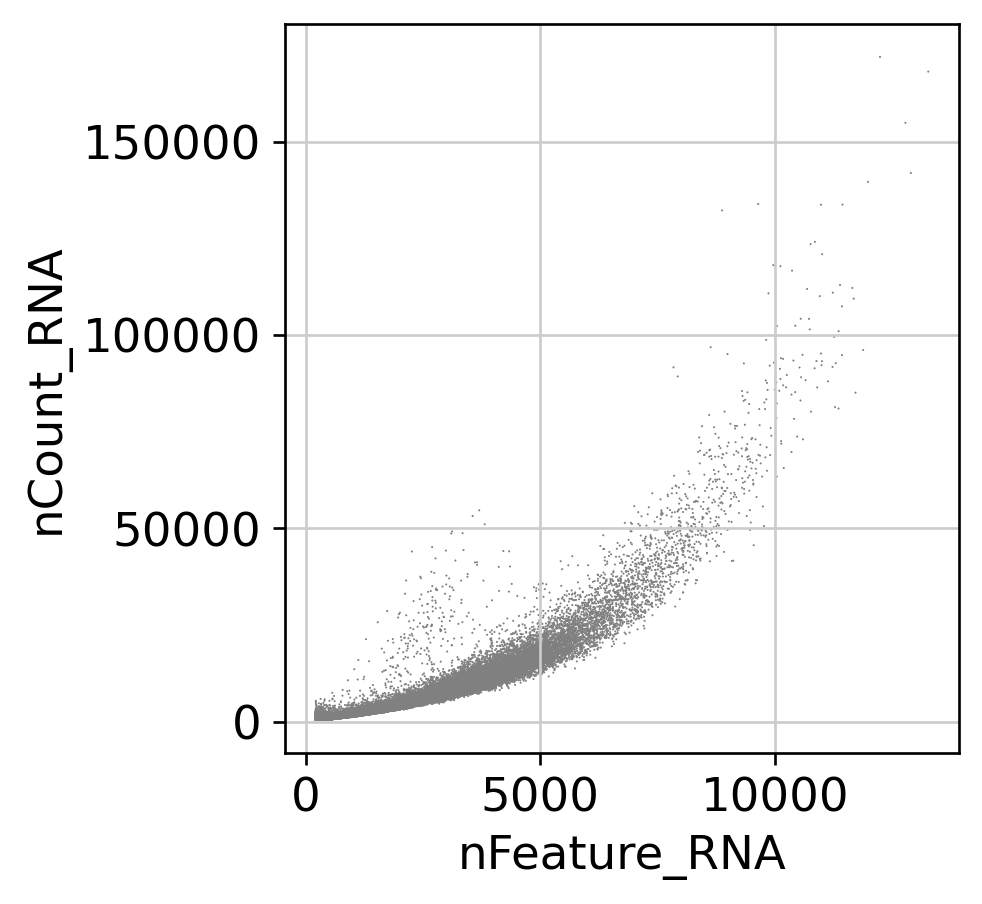

In [81]:
sc.pl.scatter(adata, x='nFeature_RNA', y='nCount_RNA')

In [82]:
adata = adata[adata.obs.nFeature_RNA < 7500, :]
adata = adata[adata.obs.nCount_RNA < 50000, :] # top 15%
adata = adata[adata.obs.nCount_RNA > 500,:]
adata = adata[adata.obs.percent_mt < 20, :] # top 10%
adata = adata[adata.obs.percent_hb < 1, :]
adata = adata[adata.obs['scDblFinder.class'] == 'singlet', :]

In [41]:
adata

View of AnnData object with n_obs × n_vars = 63228 × 29703
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes'
    var: 'n_cells'
    uns: 'SampleID_colors'

In [42]:
adata.obs.SampleID.value_counts()

SampleID
P1018S1    19252
P1013S2    11573
P1024S1     7995
P1015S2     7959
P1019S2     5233
P1024S2     4909
P1020S1     3552
P1023S2     2755
Name: count, dtype: int64

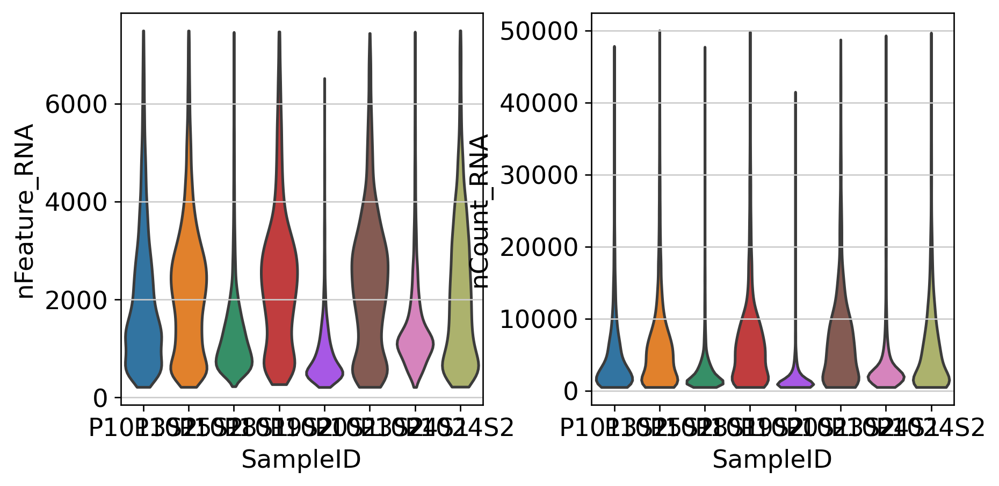

In [43]:
%%capture --no-display
sc.pl.violin(adata, ['nFeature_RNA', 'nCount_RNA'],groupby='SampleID',
             jitter=0.4, multi_panel=True,stripplot=False)

In [11]:
%%capture --no-display
# ambient RNA check each data with KRT-genelist
for sample in ['SKIN-A1002','SKIN-B1002']:
    adata_sample = adata[adata.obs['SampleID'] == sample, :]
    adata_sample.layers['count'] = adata_sample.X.copy()
    sc.pp.normalize_total(adata_sample, target_sum=1e4)
    sc.pp.log1p(adata_sample)
    adata_sample.raw = adata_sample
    sc.pp.highly_variable_genes(
    adata_sample,layer = 'count',
    flavor="seurat_v3",
    n_top_genes=2000,
    subset=True)
    sc.pp.scale(adata_sample, max_value=10)
    sc.tl.pca(adata_sample, svd_solver='arpack')
    sc.pp.neighbors(adata_sample, n_neighbors=15, n_pcs=40)
    sc.tl.umap(adata_sample,min_dist=0.2)
    sc.pl.umap(adata_sample,color = ['KRT10','KRT15','PTPRC'], 
            ncols = 5, show = False, frameon= False, save = '_'+filtertype+'_'+sample+'_gene.png')

In [83]:
adata.write_h5ad(resdir+filtertype+'_qc.h5ad')

In [52]:
adata = sc.read_h5ad(resdir+filtertype+'_qc.h5ad')

In [84]:
adata.layers['count'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

/tmp/ipykernel_2808140/3426906306.py:1: ImplicitModificationWarning: Setting element `.layers['count']` of view, initializing view as actual.
  adata.layers['count'] = adata.X.copy()


In [85]:
sc.pp.highly_variable_genes(
    adata,layer = 'count',
    flavor="seurat_v3",
    n_top_genes=3000,
    batch_key="SampleID",
    subset=False,
)

In [86]:
adata

AnnData object with n_obs × n_vars = 63228 × 29692
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'SampleID_colors', 'log1p', 'hvg'
    layers: 'count'

In [49]:
#sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
#sc.pp.scale(adata, max_value=10)

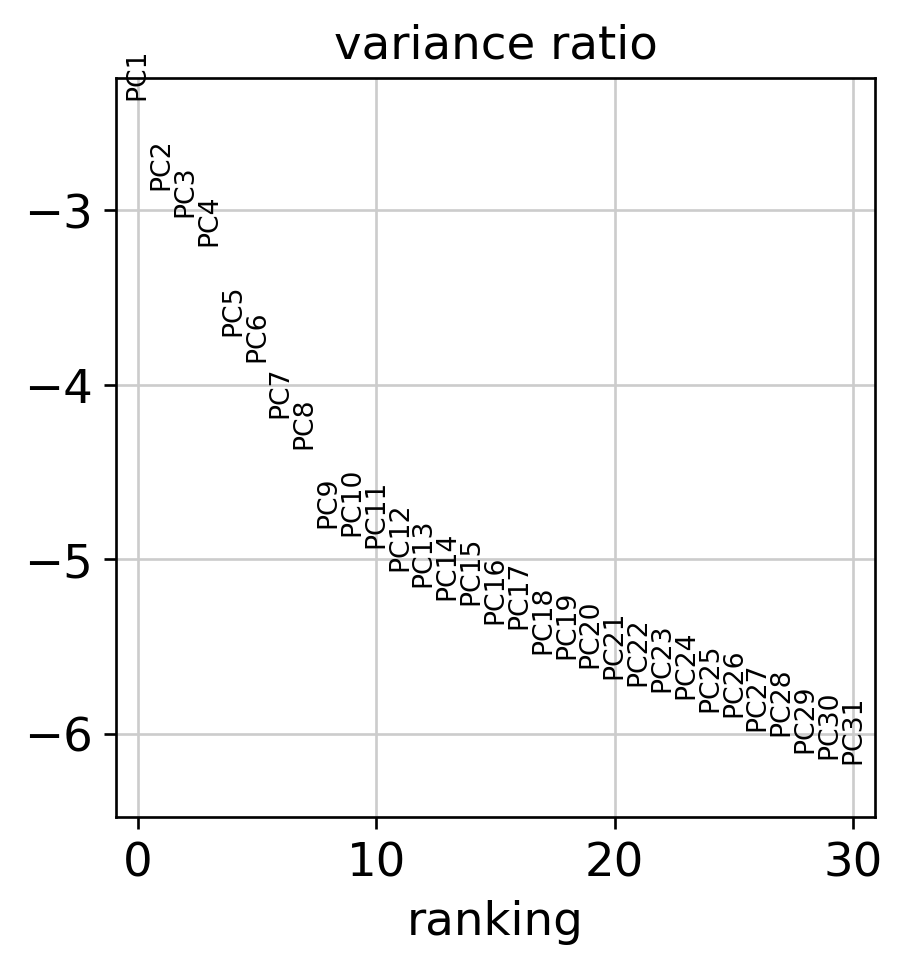

In [87]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True)

In [88]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)

In [89]:
sc.tl.umap(adata,min_dist=0.5)

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

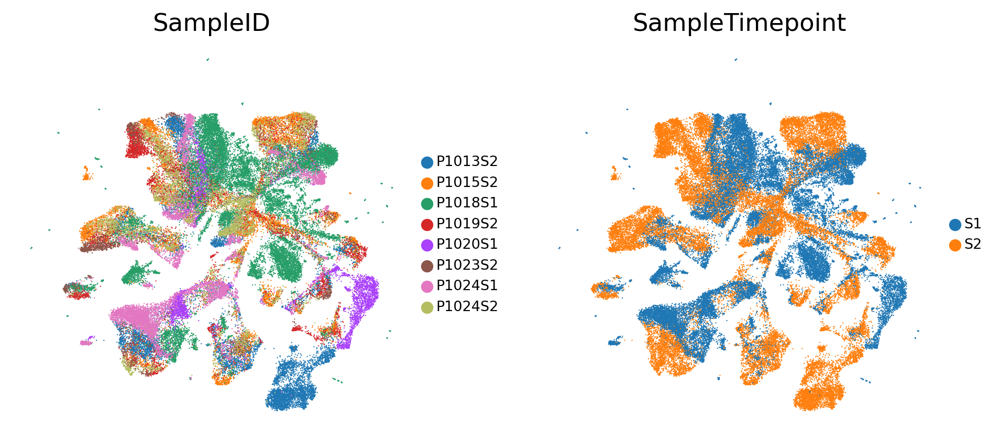

In [90]:
sc.pl.umap(adata,color = ['SampleID','SampleTimepoint'], ncols = 2,frameon=False,legend_fontsize='xx-small')

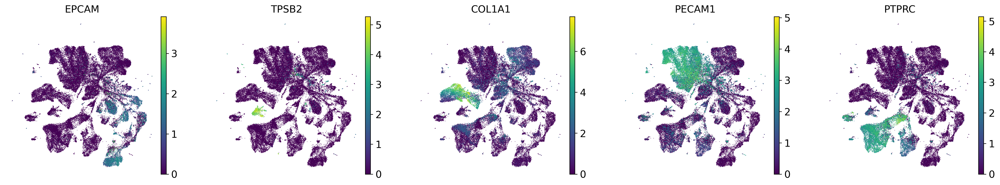

In [91]:
sc.pl.umap(adata,color = ['EPCAM','TPSB2','COL1A1','PECAM1','PTPRC'], frameon= False, ncols = 5)

In [68]:
import scanpy.external as sce

In [92]:
sce.pp.harmony_integrate(adata, ['SampleID'],max_iter_harmony=20)

2024-07-13 01:06:00,989 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-07-13 01:16:22,077 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-07-13 01:16:23,525 - harmonypy - INFO - Iteration 1 of 20
2024-07-13 01:21:26,947 - harmonypy - INFO - Iteration 2 of 20
2024-07-13 01:27:23,218 - harmonypy - INFO - Iteration 3 of 20
2024-07-13 01:32:56,642 - harmonypy - INFO - Iteration 4 of 20
2024-07-13 01:38:50,729 - harmonypy - INFO - Iteration 5 of 20
2024-07-13 01:43:30,114 - harmonypy - INFO - Iteration 6 of 20
2024-07-13 01:47:50,724 - harmonypy - INFO - Iteration 7 of 20
2024-07-13 01:52:21,128 - harmonypy - INFO - Iteration 8 of 20
2024-07-13 01:55:20,173 - harmonypy - INFO - Iteration 9 of 20
2024-07-13 01:58:24,960 - harmonypy - INFO - Iteration 10 of 20
2024-07-13 02:01:16,798 - harmonypy - INFO - Iteration 11 of 20
2024-07-13 02:04:09,880 - harmonypy - INFO - Converged after 11 iterations


In [93]:
sc.pp.neighbors(adata, use_rep='X_pca_harmony',n_neighbors=15, n_pcs=40)

In [119]:
sc.tl.umap(adata,min_dist=0.5)

In [94]:
adata

AnnData object with n_obs × n_vars = 63228 × 29692
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'SampleID_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'SampleTimepoint_colors'
    obsm: 'X_pca', 'X_umap', 'X_pca_harmony'
    varm: 'PCs'
    layers: 'count'
    obsp: 'distances', 'connectivities'

In [95]:
sc.tl.leiden(adata, resolution = 1.0, key_added = ('harmony_leiden_'+str(1)))

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


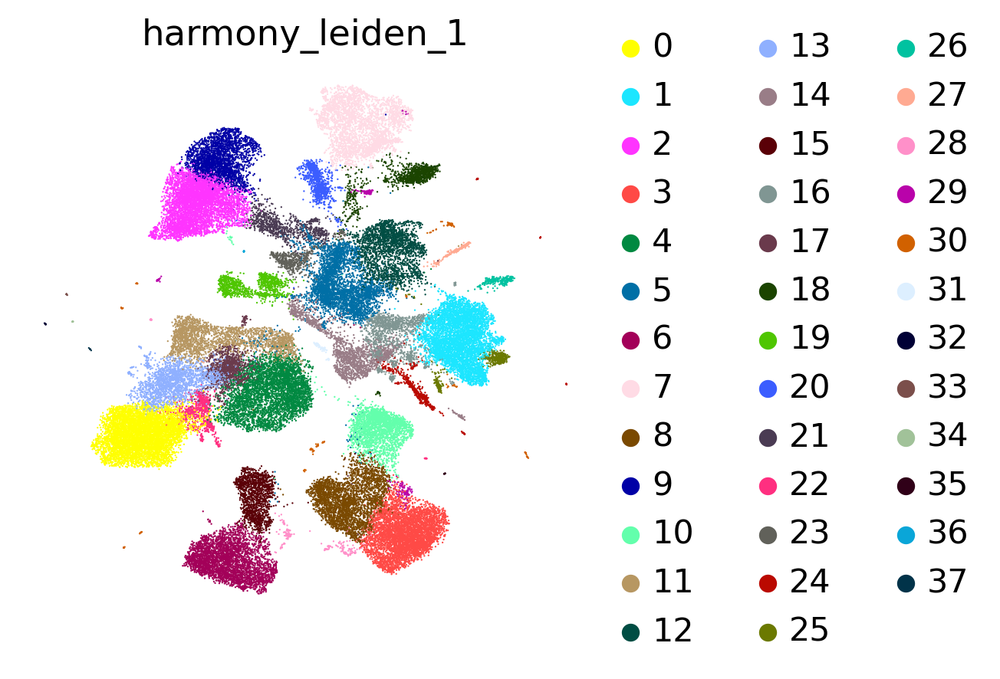

In [120]:
sc.pl.umap(adata, color=[ "harmony_leiden_1"], frameon=False, ncols=4)

In [121]:
adata.write_h5ad(resdir+filtertype+'_harmony.h5ad')

In [118]:
adata = sc.read_h5ad(resdir+filtertype+'_harmony.h5ad')

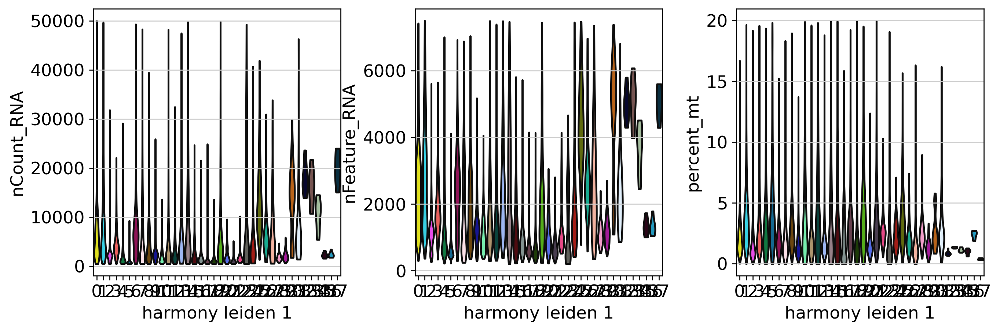

In [100]:
%%capture --no-display
sc.pl.violin(adata, ['nCount_RNA','nFeature_RNA','percent_mt'],groupby='harmony_leiden_1',
             jitter=0.4, multi_panel=True,stripplot=False,fontszie=1)

In [101]:
pd.crosstab(adata.obs['harmony_leiden_1'],adata.obs['SampleID'])

SampleID,P1013S2,P1015S2,P1018S1,P1019S2,P1020S1,P1023S2,P1024S1,P1024S2
harmony_leiden_1,,,,,,,,
0,890,588,2254,1182,131,272,388,281
1,1910,245,1789,241,900,61,27,50
2,989,130,625,162,650,237,2144,178
3,671,873,1969,211,6,161,507,451
4,541,409,1531,466,232,65,495,445
5,544,454,1123,288,216,37,759,434
6,417,911,530,334,3,574,293,500
7,1134,557,459,173,56,191,300,219
8,322,861,902,221,8,126,233,394


In [ ]:
# 20, 26 keep
# 18, 19, 22, 24, 25 remove

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


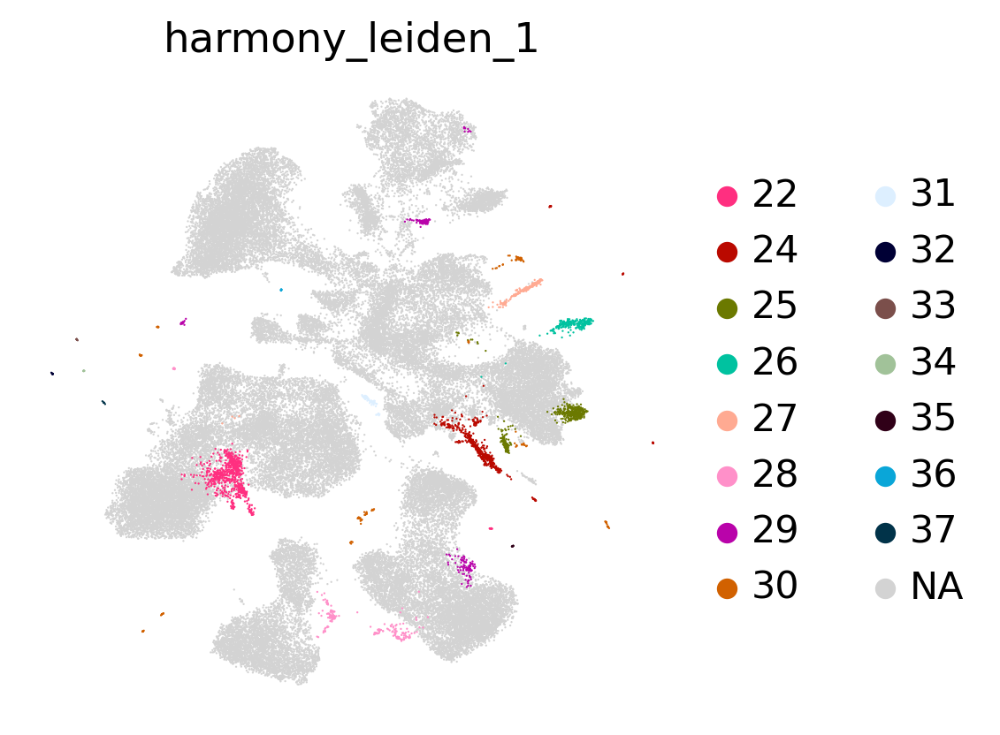

In [132]:
cluster_select = 'harmony_leiden_1'
remove_group = ['22','24','25','26','27','28','29','30','31','32','33','34','35','36','37']
sc.pl.umap(adata, color=[cluster_select], groups=remove_group, frameon=False)

In [123]:
%%capture --no-display
sc.tl.rank_genes_groups(adata, cluster_select, groups=remove_group, method='wilcoxon')

In [124]:
marker_enrich = pd.DataFrame(adata.uns['rank_genes_groups']['names'])

In [126]:
marker_enrich.to_csv(resdir+'first_round_remove_deg.csv')

In [125]:
import gseapy as gp

In [133]:
interest_cluster = '25'
marker_enrich[interest_cluster].head(10)

0       MIEN1
1     TSPAN13
2        KRT7
3     STARD10
4      MAGED2
5    ANKRD30A
6       FXYD3
7        MLPH
8      SMIM22
9    ATP6V1G1
Name: 25, dtype: object

In [134]:
enr = gp.enrichr(marker_enrich[interest_cluster].head(30), gene_sets=['Azimuth_2023'], organism='human', outdir=None)
enr.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Azimuth_2023,Lung v1-L2-Differentiating Basal,3/9,2.542401e-07,0.000005,0,0,369.703704,5613.945898,KRT19;XBP1;KRT7
1,Azimuth_2023,Lung V2 (HLCA)-ann Finest level-AT1,3/9,2.542401e-07,0.000005,0,0,369.703704,5613.945898,TSPAN13;FXYD3;KRT7
2,Azimuth_2023,Lung V2 (HLCA)-ann Level 3-AT1,3/9,2.542401e-07,0.000005,0,0,369.703704,5613.945898,TSPAN13;FXYD3;KRT7
3,Azimuth_2023,Lung V2 (HLCA)-ann Level 4-Neuroendocrine,2/9,7.779049e-05,0.000553,0,0,203.704082,1927.344411,CLDN3;TFF3
4,Azimuth_2023,Lung V2 (HLCA)-ann Finest level-Neuroendocrine,2/9,7.779049e-05,0.000553,0,0,203.704082,1927.344411,CLDN3;TFF3


In [135]:
index_keep = adata.obs[adata.obs[cluster_select].isin(remove_group)==False].index

In [136]:
adata = adata[adata.obs.index.isin(index_keep),:]
adata

View of AnnData object with n_obs × n_vars = 60405 × 29692
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes', 'harmony_leiden_1'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'SampleID_colors', 'SampleTimepoint_colors', 'harmony_leiden_1_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'rank_genes_groups'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'count'
    obsp: 'connectivities', 'distances'

In [137]:
adata.obs['SampleID'].value_counts()

SampleID
P1018S1    17442
P1013S2    11020
P1024S1     7991
P1015S2     7784
P1019S2     5116
P1024S2     4818
P1020S1     3550
P1023S2     2684
Name: count, dtype: int64

In [138]:
adata.write_h5ad(resdir+filtertype+'_filter_harmony.h5ad')

In [139]:
adata

View of AnnData object with n_obs × n_vars = 60405 × 29692
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes', 'harmony_leiden_1'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'SampleID_colors', 'SampleTimepoint_colors', 'harmony_leiden_1_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap', 'rank_genes_groups'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'count'
    obsp: 'connectivities', 'distances'

In [141]:
sc.tl.pca(adata, svd_solver='arpack')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca


In [142]:
sce.pp.harmony_integrate(adata, ['SampleID'],max_iter_harmony=20)
sc.pp.neighbors(adata, use_rep='X_pca_harmony',n_neighbors=15, n_pcs=40)

2024-07-13 03:07:39,272 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-07-13 03:16:13,579 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-07-13 03:16:14,579 - harmonypy - INFO - Iteration 1 of 20
2024-07-13 03:19:11,962 - harmonypy - INFO - Iteration 2 of 20
2024-07-13 03:21:54,698 - harmonypy - INFO - Iteration 3 of 20
2024-07-13 03:24:55,254 - harmonypy - INFO - Iteration 4 of 20
2024-07-13 03:28:30,921 - harmonypy - INFO - Iteration 5 of 20
2024-07-13 03:31:14,033 - harmonypy - INFO - Iteration 6 of 20
2024-07-13 03:34:46,752 - harmonypy - INFO - Converged after 6 iterations


/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


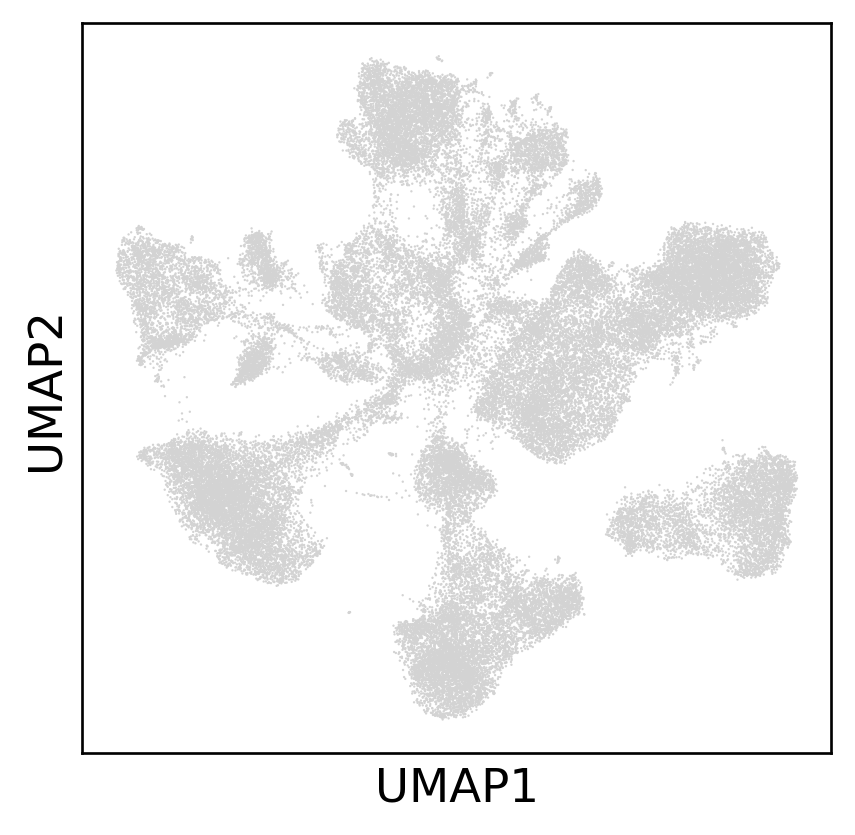

In [143]:
sc.tl.umap(adata,min_dist=0.5)
sc.pl.umap(adata)

In [144]:
sc.tl.leiden(adata, resolution = 1.0, key_added = ('harmony_leiden_'+str(1)))

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


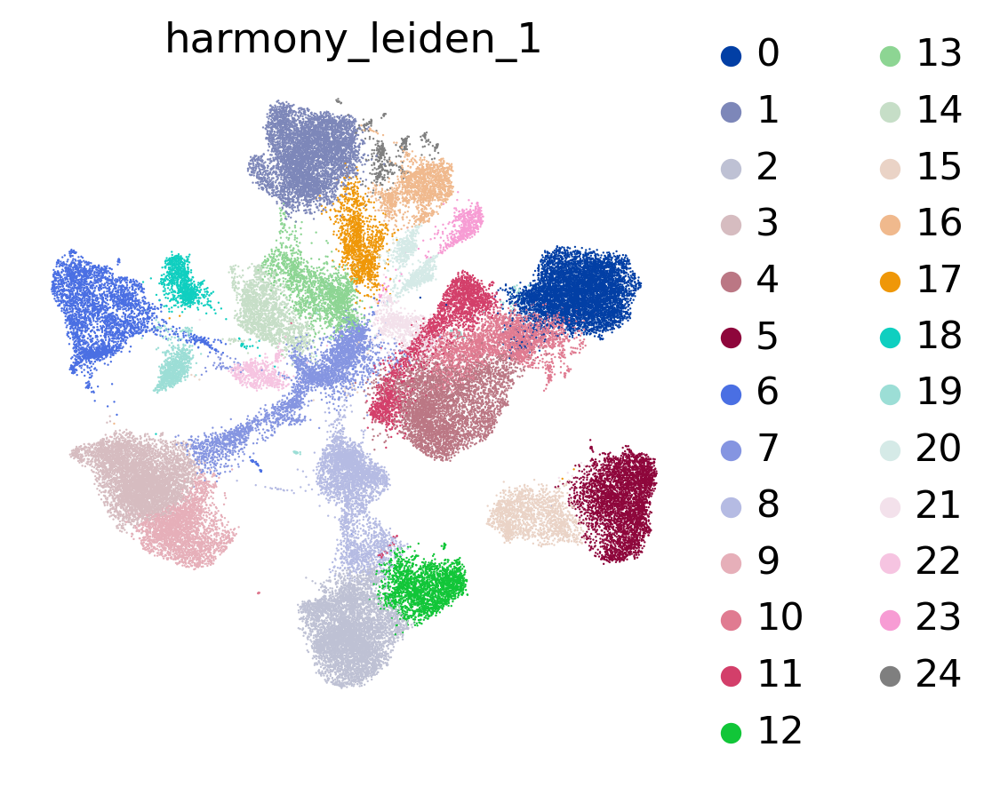

In [145]:
sc.pl.umap(adata, color=['harmony_leiden_1'], frameon=False)

In [146]:
adata.write_h5ad(resdir+filtertype+'_first_reharmony.h5ad')

In [ ]:
adata = sc.read_h5ad(resdir+filtertype+'_first_reharmony.h5ad')

In [89]:
pd.crosstab(adata_keep.obs['keep_leiden_0.8'],adata_keep.obs['SampleID'])

SampleID,SKIN-A1002,SKIN-A1007,SKIN-A1009,SKIN-B1002,SKIN-B1007,SKIN-B1009
keep_leiden_0.8,,,,,,
0,315,1257,1549,1747,3468,2096
1,329,1140,1495,1820,2690,1896
2,191,456,677,1058,1723,896
3,138,419,469,1030,1396,796
4,931,207,1219,559,336,721
5,390,158,789,782,417,277
6,131,139,322,924,589,354
7,299,154,707,220,244,302
8,261,125,331,609,171,343


In [97]:
pd.crosstab(adata_keep.obs['keep_leiden_0.8'],adata.obs['harmony_leiden_1.0'])

harmony_leiden_1.0,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,20,21,23,26
keep_leiden_0.8,,,,,,,,,,,,,,,,,,,,,
0,7708,2431,2,45,1,0,26,0,1,1,...,0,3,16,7,0,2,0,0,0,0
1,50,60,4585,3969,0,594,8,1,1,0,...,0,0,60,2,1,1,0,0,0,0
2,211,4458,1,168,0,1,1,1,0,2,...,0,2,18,0,3,1,0,0,0,0
3,0,0,84,0,0,2245,0,1907,1,0,...,0,0,4,6,0,0,0,0,1,0
4,2,0,1,2,3766,0,3,0,1,133,...,47,2,2,1,6,0,0,0,5,0
5,0,1,0,0,13,0,2794,1,0,0,...,0,1,0,0,0,2,0,0,0,0
6,1,2,0,0,2,1,0,1,2449,0,...,0,1,0,0,0,0,0,0,0,0
7,0,0,0,0,84,0,2,0,0,1808,...,20,1,0,1,6,1,0,1,0,2
8,0,0,0,0,6,0,3,0,0,1,...,0,70,0,2,1,1,0,0,1,0


/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


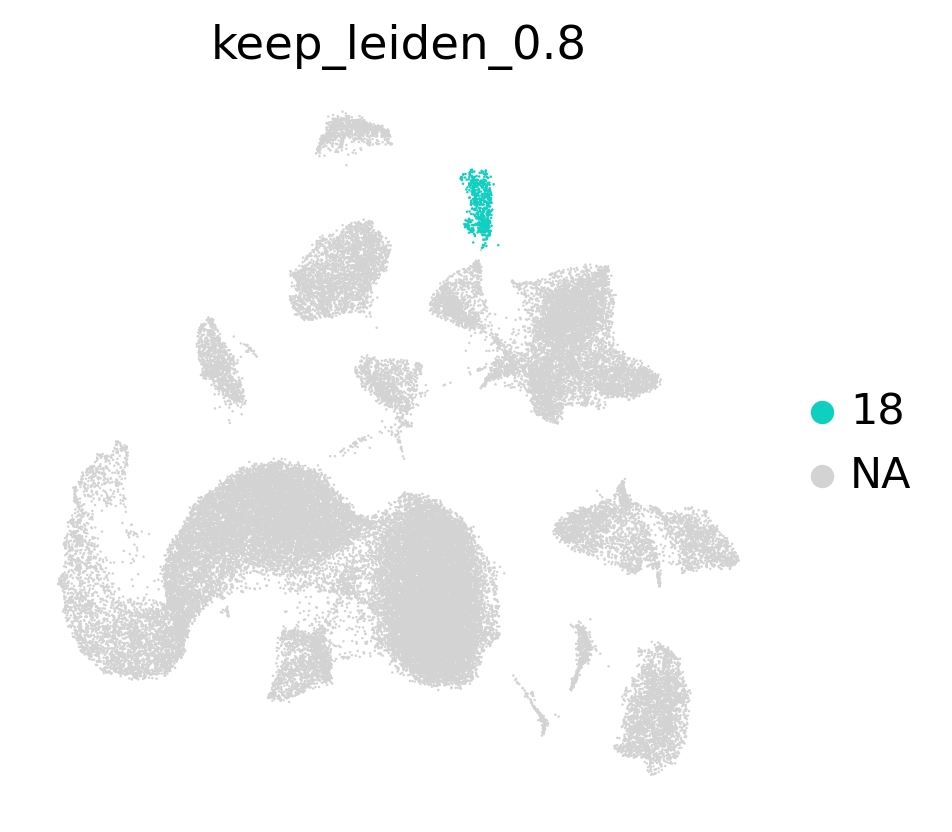

In [94]:
sec_remove_group = ['18']
sc.pl.umap(adata_keep, color=['keep_leiden_0.8'], groups=sec_remove_group, frameon=False)

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


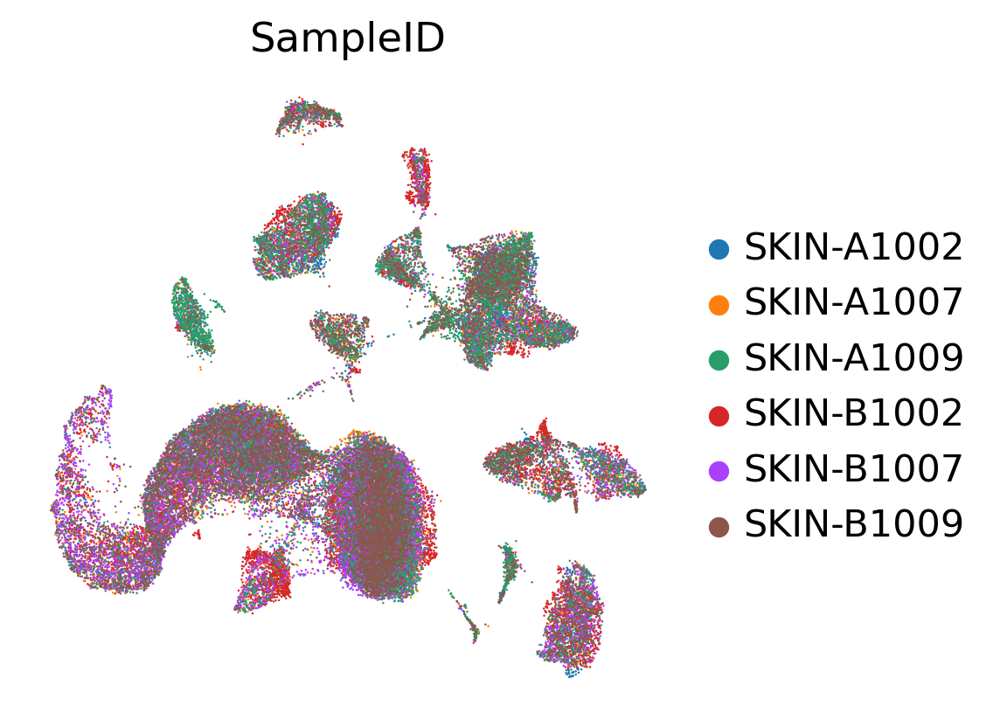

In [93]:
sc.pl.umap(adata_keep, color=['SampleID'], frameon=False, ncols=2)

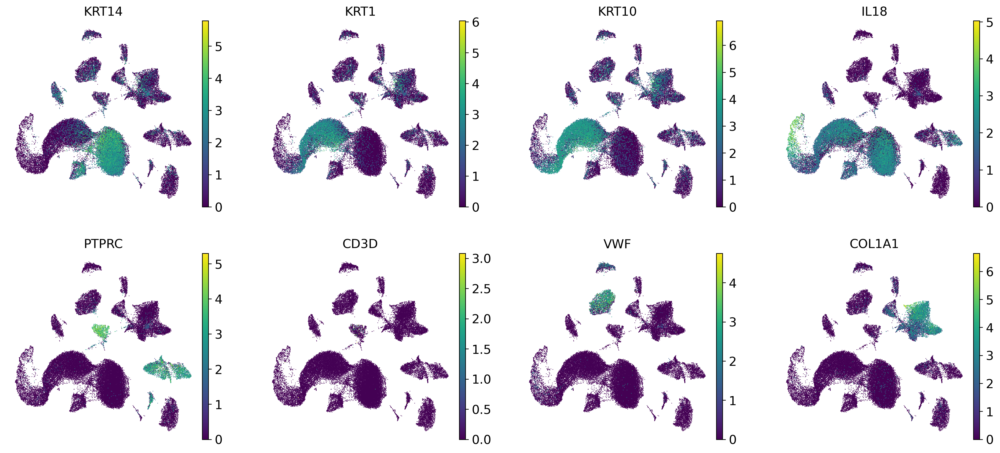

In [95]:
sc.pl.umap(adata_keep,color = ['KRT14','KRT1','KRT10','IL18','PTPRC','CD3D','VWF','COL1A1'],frameon= False, ncols = 4, use_raw = True)

In [98]:
adata_keep.write_h5ad(resdir+'/'+filtertype+'_keep.h5ad')

In [99]:
index_keep = adata_keep.obs.index

In [108]:
adata_deg = sc.read_h5ad(resdir+'/'+filtertype+'_qc.h5ad')
adata_deg = adata_deg[adata_deg.obs.index.isin(index_keep),:]

In [36]:
select_cluster = 'keep_leiden_0.8'
adata_deg.obs = adata_deg.obs.join(adata_keep.obs[select_cluster], how='left')

In [111]:
sc.pp.normalize_total(adata_deg, target_sum = 1e4)
sc.pp.log1p(adata_deg)

In [112]:
%%capture --no-display
sc.tl.rank_genes_groups(adata_deg, select_cluster, method='wilcoxon')

In [113]:
adata_deg.write_h5ad(resdir+'/'+filtertype+'_deg.h5ad')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

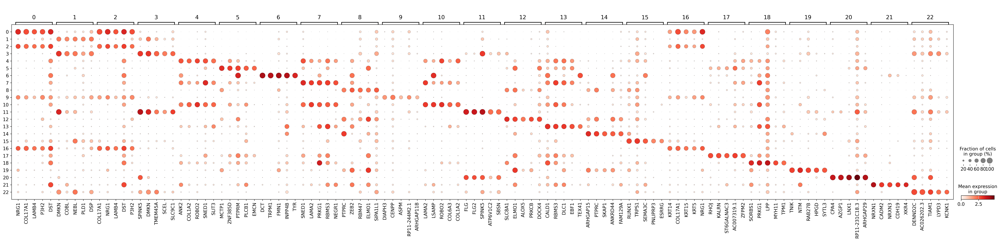

In [114]:
sc.pl.rank_genes_groups_dotplot(adata_deg, key='rank_genes_groups',dendrogram=False,n_genes =5)

In [115]:
marker_enrich = pd.DataFrame(adata_deg.uns['rank_genes_groups']['names'])

In [148]:
enr = gp.enrichr(marker_enrich['21'].head(30), gene_sets=['Azimuth_2023'], organism='human', outdir=None)
enr.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Azimuth_2023,Heart-L2-Neuronal,7/9,2.880461e-19,3.485358e-17,0,0,3038.608696,129721.749569,CADM2;ADGRB3;NRXN3;SORCS1;NCAM2;XKR4;CDH19
1,Azimuth_2023,Kidney-L1-Schwann,6/9,5.594777e-16,2.256560e-14,0,0,1663.916667,58435.968085,STARD13;CADM2;ADGRB3;NRXN1;ZNF536;SCN7A
2,Azimuth_2023,Heart-L1-Neuronal,6/9,5.594777e-16,2.256560e-14,0,0,1663.916667,58435.968085,CADM2;NRXN3;SORCS1;NCAM2;XKR4;CDH19
3,Azimuth_2023,Kidney-L2-Schwann / Neural,4/9,5.153083e-10,1.247046e-08,0,0,614.307692,13137.741416,CADM2;NRXN1;ZNF536;SCN7A
4,Azimuth_2023,Kidney-L3-Schwann / Neural,4/9,5.153083e-10,1.247046e-08,0,0,614.307692,13137.741416,CADM2;NRXN1;ZNF536;SCN7A


In [129]:
import celltypist

In [130]:
pred_GTEx_major = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_major_from_GTEx.pkl', majority_voting = True)
pred_GTEx_minor = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_minor_from_GTEx.pkl', majority_voting = True)
pred_TS_compart = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_compartment_from_TS.pkl', majority_voting = True)
pred_TS_subset = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_subset_from_TS.pkl', majority_voting = True)
pred_deve_minor = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_minor_from_Develop.pkl', majority_voting = True)
pred_deve_subset = celltypist.annotate(adata_deg, model = '/home/zhepan/Reference/celltypist/skin_subset_from_Develop.pkl', majority_voting = True)

🔬 Input data has 53708 cells and 28487 genes
🔗 Matching reference genes in the model
🧬 3204 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Can not detect a neighborhood graph, will construct one before the over-clustering


⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 53708 cells and 28487 genes
🔗 Matching reference genes in the model
🧬 3204 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 53708 cells and 28487 genes
🔗 Matching reference genes in the model
🧬 3352 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 20
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 53708 cells and 28487 genes
🔗 Matching reference genes in the model
🧬 3352 fea

In [131]:
adata_keep.obs = adata_keep.obs.join(pred_GTEx_major.predicted_labels['majority_voting']).rename(columns={'majority_voting':'GTEx_major'})
adata_keep.obs = adata_keep.obs.join(pred_GTEx_minor.predicted_labels['majority_voting']).rename(columns={'majority_voting':'GTEx_minor'})
adata_keep.obs = adata_keep.obs.join(pred_TS_compart.predicted_labels['majority_voting']).rename(columns={'majority_voting':'TS_compart'})
adata_keep.obs = adata_keep.obs.join(pred_TS_subset.predicted_labels['majority_voting']).rename(columns={'majority_voting':'TS_subset'})
adata_keep.obs = adata_keep.obs.join(pred_deve_minor.predicted_labels['majority_voting']).rename(columns={'majority_voting':'deve_minor'})
adata_keep.obs = adata_keep.obs.join(pred_deve_subset.predicted_labels['majority_voting']).rename(columns={'majority_voting':'deve_subset'})

In [132]:
pd.crosstab(adata_keep.obs['SampleID'], adata_keep.obs['GTEx_major'])

GTEx_major,Adipocyte,Endothelial cell,Epithelial cell,Epithelial cell (keratinocyte),Fibroblast,Immune (lymphocyte),Immune (myeloid),Melanocyte,Muscle,Other
SampleID,,,,,,,,,,
SKIN-A1002,1,499,154,1259,1466,138,346,125,75,105
SKIN-A1007,0,264,66,3543,539,155,297,148,65,58
SKIN-A1009,5,986,86,4599,2278,252,750,340,390,515
SKIN-B1002,0,936,404,6625,1124,133,816,928,586,102
SKIN-B1007,0,547,368,10138,847,99,469,587,176,15
SKIN-B1009,0,441,111,6214,1202,233,514,362,186,41


In [147]:
pd.crosstab(adata_keep.obs['keep_leiden_0.8'], adata_keep.obs['deve_minor'])

deve_minor,Dermal APC,Epidermal APC,Fibroblast,ILC,Keratinocyte basal,Keratinocyte suprabasal,Lymphatic endothelium,Mast cell,Melanocyte,NK,Pericyte,Plasma cell,Schwann,Stromal Schwann,Tc lymphocyte,Th lymphocyte,Treg lymphocyte,Vascular endothelium,pDC
keep_leiden_0.8,,,,,,,,,,,,,,,,,,,
0,10,50,0,11,9502,597,1,0,0,76,0,3,9,1,10,151,6,3,2
1,10,110,1,9,424,8523,0,0,0,58,2,25,3,2,14,182,3,2,2
2,19,39,2,5,4259,398,1,0,0,20,2,18,1,0,12,222,1,0,2
3,9,13,12,0,51,4082,1,0,0,55,0,1,2,1,3,12,5,1,0
4,9,4,3721,0,20,31,4,0,1,33,16,21,3,46,23,20,5,15,1
5,2,1,25,1,16,6,3,0,0,16,2,2,1,1,1,6,3,2727,0
6,5,4,12,0,13,8,1,0,2399,3,2,1,0,0,3,3,1,2,2
7,5,4,1551,1,6,10,4,0,1,38,36,20,1,224,10,12,3,0,0
8,1489,103,33,2,6,8,3,0,8,27,5,70,11,1,6,6,25,4,33


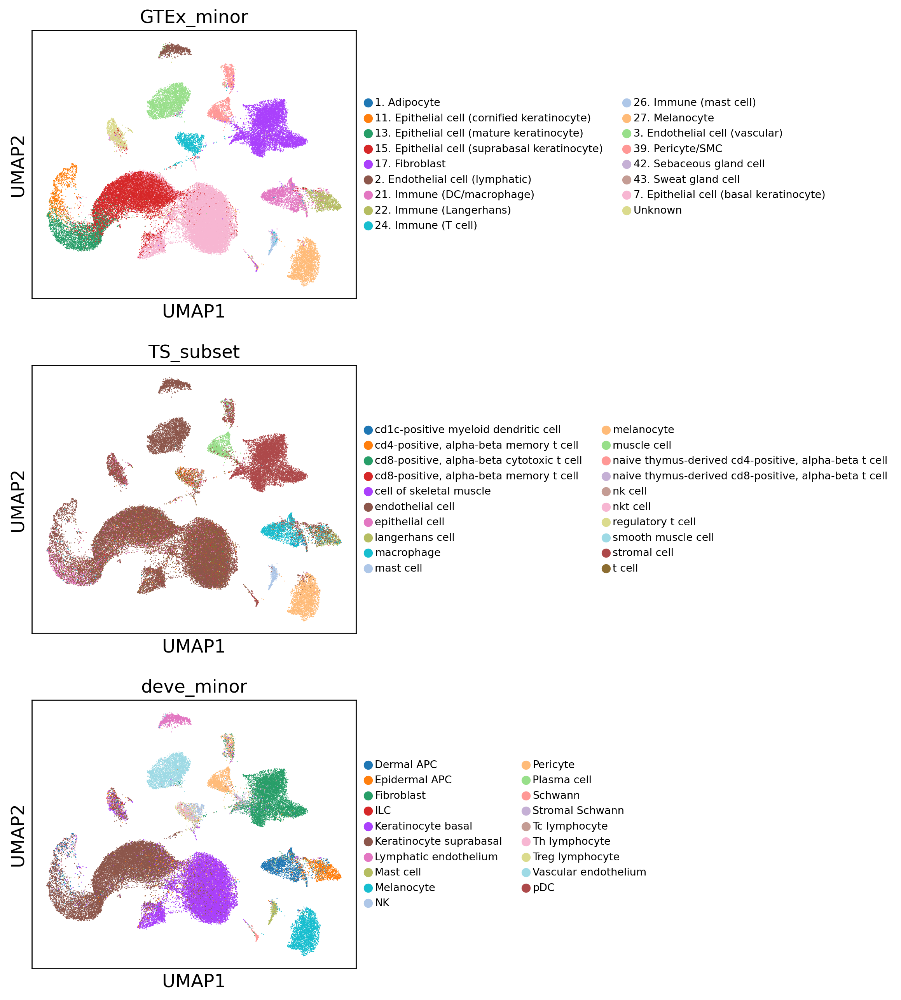

In [134]:
sc.pl.umap(adata_keep, color = ['GTEx_minor','TS_subset','deve_minor'], ncols=1, legend_fontsize='xx-small')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


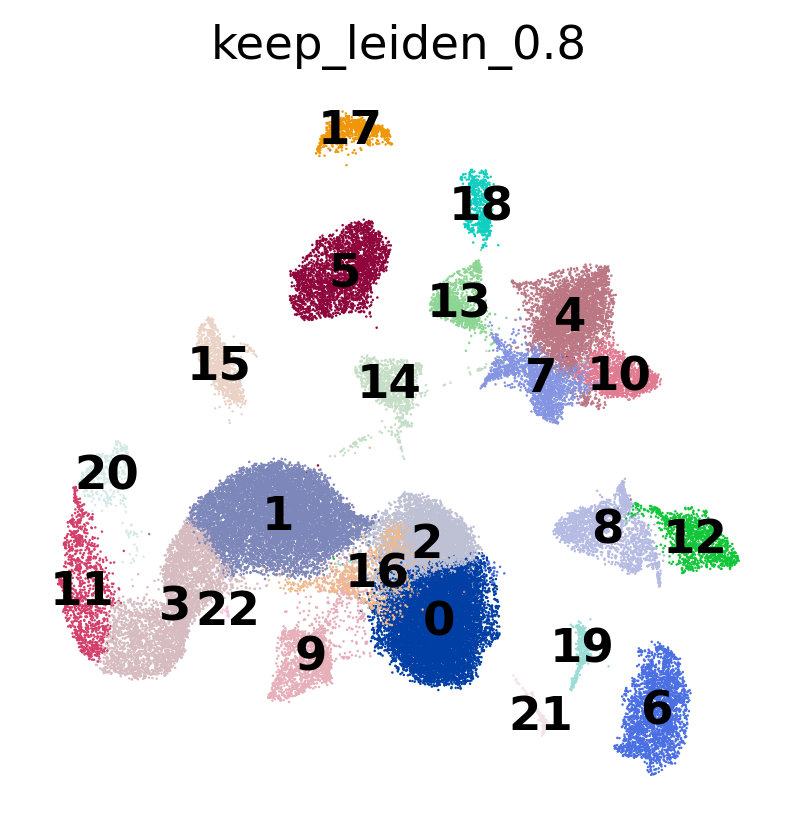

In [121]:
sc.pl.umap(adata_keep, color=[select_cluster], frameon=False, legend_loc='on data')

In [32]:
adata_keep = sc.read_h5ad(resdir+'/'+filtertype+'_anno.h5ad')

In [33]:
cl_major={
    "0": "Keratinocyte",
    "1": "Keratinocyte",
    "2": "Keratinocyte",
    "3": "Keratinocyte",
    "4": "Fibroblast",
    "5": "Endothelial",
    "6": "Melanocyte",
    "7": "Fibroblast",
    "8": "Myeloid",
    "9": "Keratinocyte",
    "10": "Fibroblast",
    "11": "Keratinocyte",
    "12": "Myeloid",
    "13": "PVL",
    "14": "T cell",
    "15": "Eccrine gland",
    "16": "Keratinocyte",
    "17": "Endothelial",
    "18": "PVL",
    "19": "Mast cell",
    "20": "Keratinocyte",
    "21": "Schwann",
    "22": "Keratinocyte",
}

In [37]:
adata_keep.obs["cl_major"] = adata_keep.obs[select_cluster].map(cl_major)

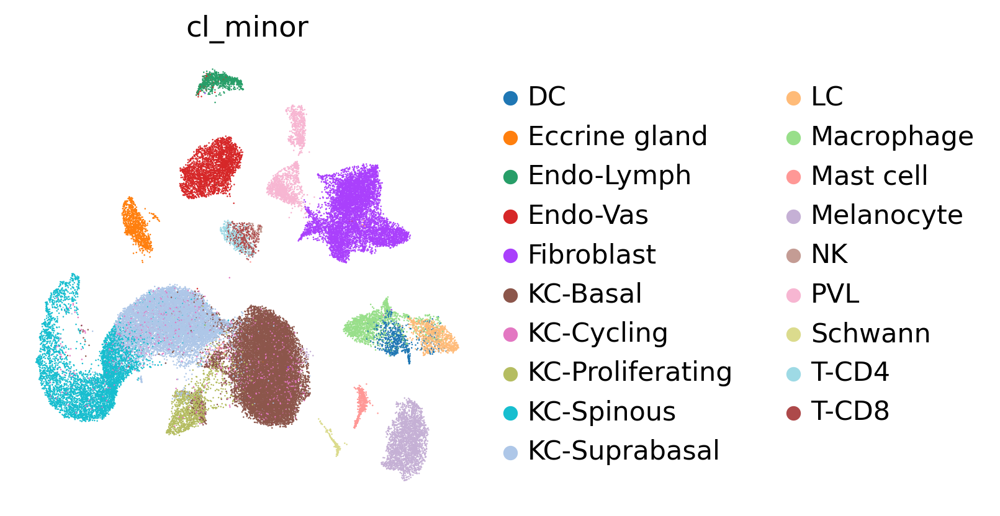

In [616]:
sc.pl.umap(adata_keep,color = ['cl_major'], frameon=False)

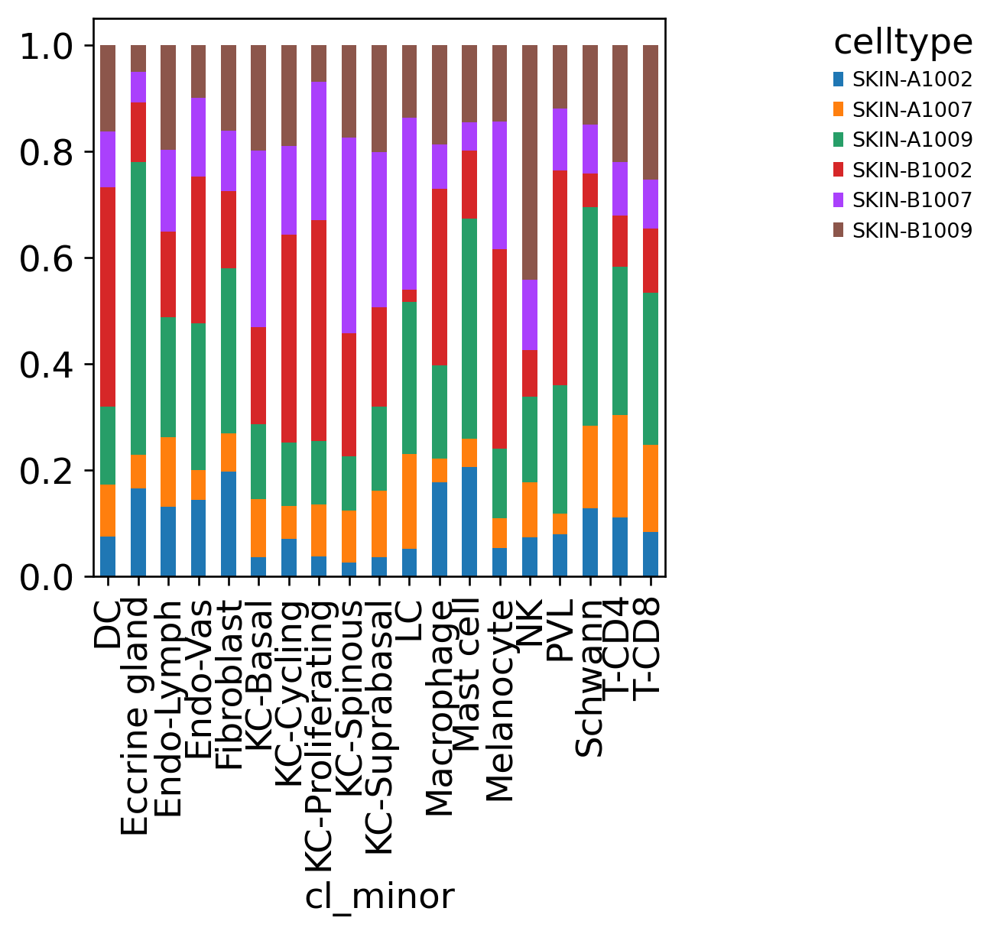

In [668]:
tmp = pd.crosstab(adata_keep.obs['SampleID'],adata_keep.obs['cl_minor'], normalize='columns').T.plot(kind='bar', stacked=True,figsize = (4,4))
plt.grid(False)
tmp.legend(title='celltype', bbox_to_anchor=(1.26, 1.02),loc='best',frameon = False,fontsize='xx-small')

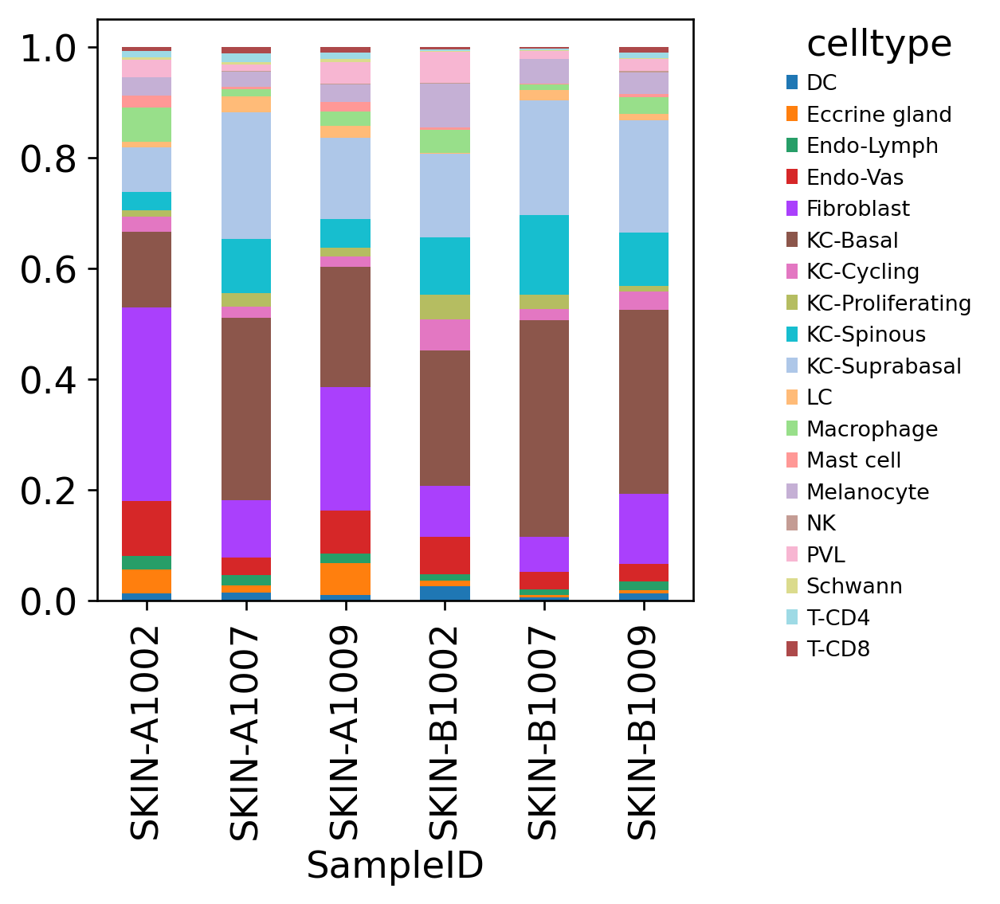

In [667]:
tmp = pd.crosstab(adata_keep.obs['cl_minor'],adata_keep.obs['SampleID'], normalize='columns').T.plot(kind='bar', stacked=True,figsize = (4,4))
plt.grid(False)
tmp.legend(title='celltype', bbox_to_anchor=(1.5, 1.02),loc='best',frameon = False, fontsize='xx-small')

In [614]:
adata_keep.obs.to_csv(resdir +'/'+filtertype+ '_celltype.csv')

In [46]:
adata_keep.write_h5ad(resdir+'/'+filtertype+'_anno.h5ad')

In [579]:
adata_keep = sc.read_h5ad(resdir+'/'+filtertype+'_anno.h5ad')
anno = pd.read_table(resdir+'/'+filtertype+'_celltype.txt',sep = '\t',index_col=0)

In [589]:
adata_keep.obs = anno

In [612]:
adata_keep = adata_keep[adata_keep.obs['cl_subset'].isin(['Keratinocyte','Fibroblast'])==False]

In [591]:
select_cl = 'Keratinocyte'

In [592]:
adata_qc = sc.read_h5ad(resdir+'/'+filtertype+'_qc.h5ad')
adata_qc.obs = adata_qc.obs.join(adata_keep.obs['cl_major'], how='left')

In [593]:
adata_subcluster = adata_qc[adata_qc.obs['cl_major'] == select_cl,:]
adata_subcluster

View of AnnData object with n_obs × n_vars = 33133 × 28487
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'SampleID', 'SampleType', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'percent.rb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'n_genes', 'cl_major'
    var: 'n_cells'
    uns: 'SampleID_colors'

In [594]:
adata_subcluster.layers['count'] = adata_subcluster.X.copy()
sc.pp.normalize_total(adata_subcluster, target_sum=1e4)
sc.pp.log1p(adata_subcluster)
adata_subcluster.raw = adata_subcluster
sc.pp.highly_variable_genes(
    adata_subcluster,layer = 'count',
    flavor="seurat_v3",
    n_top_genes=2000,
    subset=True,
)

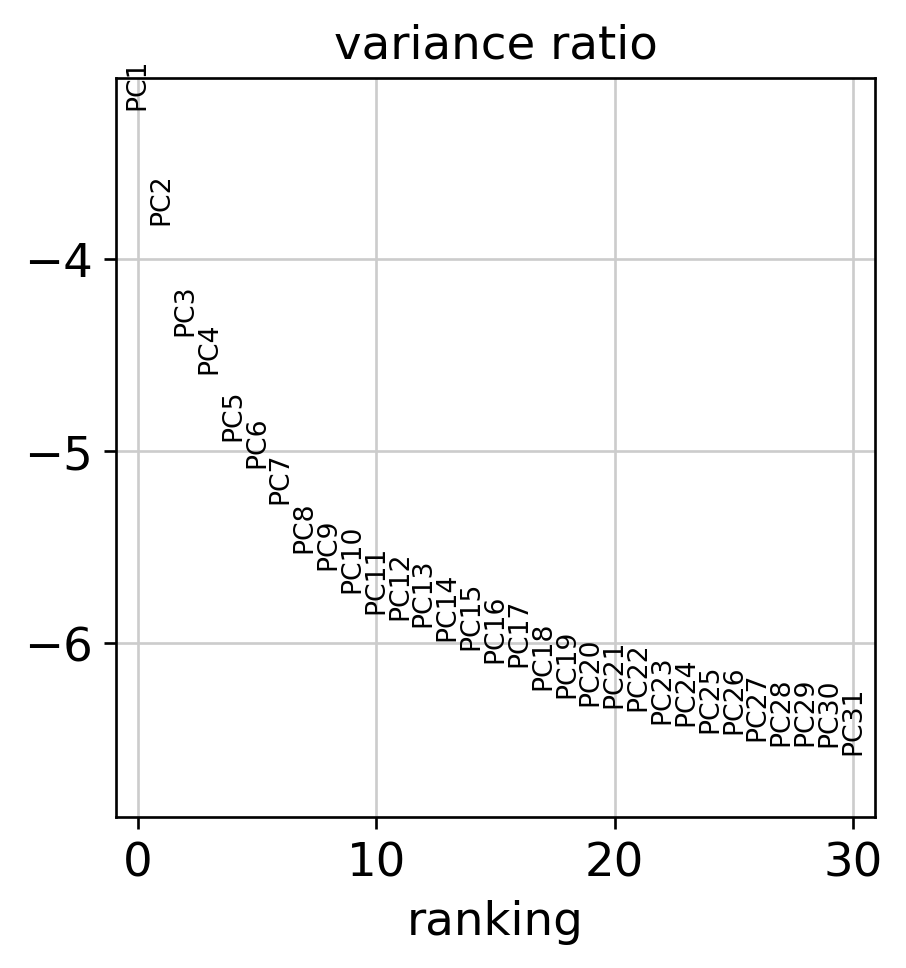

In [595]:
sc.pp.scale(adata_subcluster)
sc.tl.pca(adata_subcluster, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_subcluster, log=True)

In [596]:
sce.pp.harmony_integrate(adata_subcluster, ['SampleID'],max_iter_harmony=20)
sc.pp.neighbors(adata_subcluster, use_rep='X_pca_harmony',n_neighbors=15, n_pcs=30)

2023-12-30 00:09:43,216 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...


2023-12-30 00:12:08,973 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2023-12-30 00:12:09,334 - harmonypy - INFO - Iteration 1 of 20
Iteration 1 of 20
2023-12-30 00:13:08,883 - harmonypy - INFO - Iteration 2 of 20
Iteration 2 of 20
2023-12-30 00:14:05,802 - harmonypy - INFO - Iteration 3 of 20
Iteration 3 of 20
2023-12-30 00:15:05,094 - harmonypy - INFO - Iteration 4 of 20
Iteration 4 of 20
2023-12-30 00:16:03,924 - harmonypy - INFO - Iteration 5 of 20
Iteration 5 of 20
2023-12-30 00:17:05,298 - harmonypy - INFO - Iteration 6 of 20
Iteration 6 of 20
2023-12-30 00:18:04,770 - harmonypy - INFO - Iteration 7 of 20
Iteration 7 of 20
2023-12-30 00:19:12,609 - harmonypy - INFO - Iteration 8 of 20
Iteration 8 of 20
2023-12-30 00:20:11,581 - harmonypy - INFO - Iteration 9 of 20
Iteration 9 of 20
2023-12-30 00:20:59,818 - harmonypy - INFO - Converged after 9 iterations
Converged after 9 iterations


In [597]:
sc.tl.umap(adata_subcluster,min_dist=0.5)

In [598]:
for i in [0.2,0.4,0.6]:
    sc.tl.leiden(adata_subcluster, resolution = i, key_added = ('leiden_'+str(i)))

... storing 'cl_major' as categorical


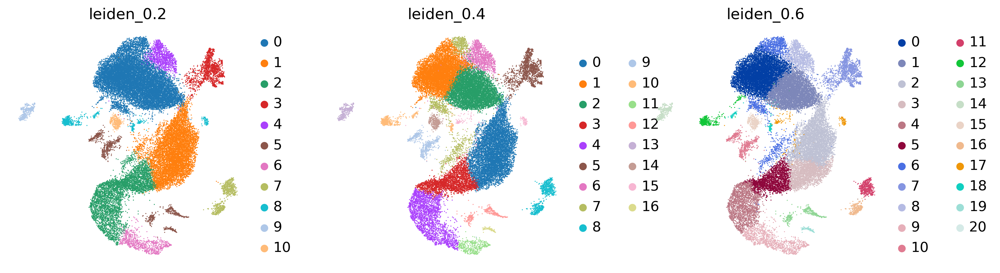

In [601]:
sc.pl.umap(adata_subcluster, color=['leiden_0.2','leiden_0.4','leiden_0.6'], frameon=False)

In [550]:
import celltypist

In [602]:
adata_subcluster_raw = adata_qc[adata_qc.obs['cl_major'] == select_cl,:]
sc.pp.normalize_total(adata_subcluster_raw, target_sum=1e4)
sc.pp.log1p(adata_subcluster_raw)
pred_GTEx_minor = celltypist.annotate(adata_subcluster_raw, model = '/home/zhepan/Reference/celltypist/skin_minor_from_GTEx.pkl', majority_voting = True)
pred_deve_subset = celltypist.annotate(adata_subcluster_raw, model = '/home/zhepan/Reference/celltypist/skin_subset_from_Develop.pkl', majority_voting = True)

🔬 Input data has 33133 cells and 28487 genes
🔗 Matching reference genes in the model
🔗 Matching reference genes in the model
🧬 3204 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Can not detect a neighborhood graph, will construct one before the over-clustering
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 33133 cells and 28487 genes
🔗 Matching reference genes in the model
🧬 2314 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


In [603]:
adata_subcluster.obs = adata_subcluster.obs.join(pred_GTEx_minor.predicted_labels['majority_voting']).rename(columns={'majority_voting':'GTEx_minor'})
adata_subcluster.obs = adata_subcluster.obs.join(pred_deve_subset.predicted_labels['majority_voting']).rename(columns={'majority_voting':'deve_subset'})

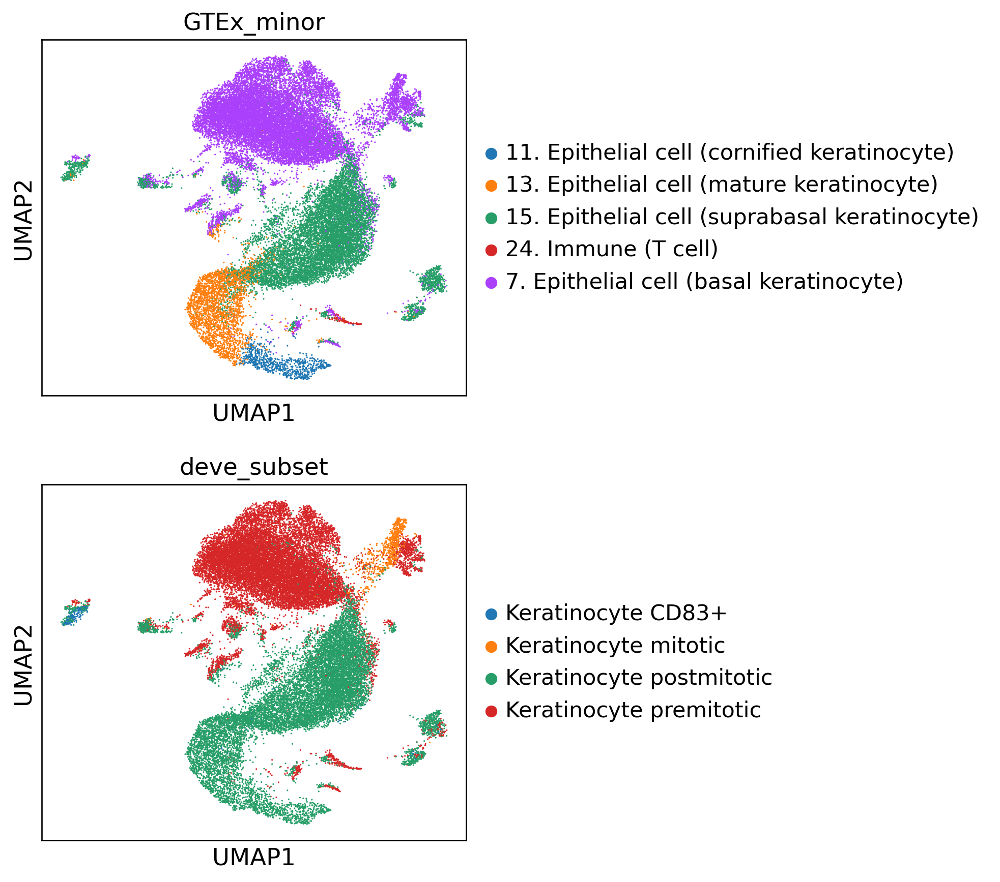

In [604]:
sc.pl.umap(adata_subcluster, color=['GTEx_minor','deve_subset'], ncols=1)

In [605]:
select_res = 'leiden_0.2'

In [606]:
adata_subcluster_raw.obs = adata_subcluster_raw.obs.join(adata_subcluster.obs[select_res])

In [ ]:
sc.tl.rank_genes_groups(adata_subcluster_raw, select_res, method='wilcoxon')

In [ ]:
adata = sc.read_h5ad(resdir+'/'+filtertype+'_anno_count.h5ad')

In [ ]:
adata.layers['count'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [ ]:
marker_enrich = pd.DataFrame(adata_subcluster_raw.uns['rank_genes_groups']['names'])

In [571]:
interest_cluster = '6'
marker_enrich[interest_cluster].head(10)

0            HPSE2
1           PCDH15
2          COL24A1
3             TCF4
4            PTPRK
5            CADM2
6             NRG3
7             COCH
8           LIMCH1
9    RP11-829H16.3
Name: 6, dtype: object

In [572]:
enr = gp.enrichr(marker_enrich[interest_cluster].head(30), gene_sets=['Azimuth_2023'], organism='human', outdir=None)
enr.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Azimuth_2023,Fetal Development-L2-Eye-Ganglion Cells,3/9,2.542401e-07,0.000022,0,0,369.703704,5613.945898,ROBO2;NRG3;CADM2
1,Azimuth_2023,Fetal Development-L1-Ganglion Cells,3/9,2.542401e-07,0.000022,0,0,369.703704,5613.945898,ROBO2;NRG3;CADM2
2,Azimuth_2023,Fetal Development-L1-Excitatory Neurons,2/9,7.779049e-05,0.001109,0,0,203.704082,1927.344411,PTPRD;ROBO2
3,Azimuth_2023,Motor Cortex-cross-species cluster-Layer 6 Glu...,2/9,7.779049e-05,0.001109,0,0,203.704082,1927.344411,TENM3;MEIS2
4,Azimuth_2023,Fetal Development-L1-Amacrine Cells,2/9,7.779049e-05,0.001109,0,0,203.704082,1927.344411,CADM2;MEIS2


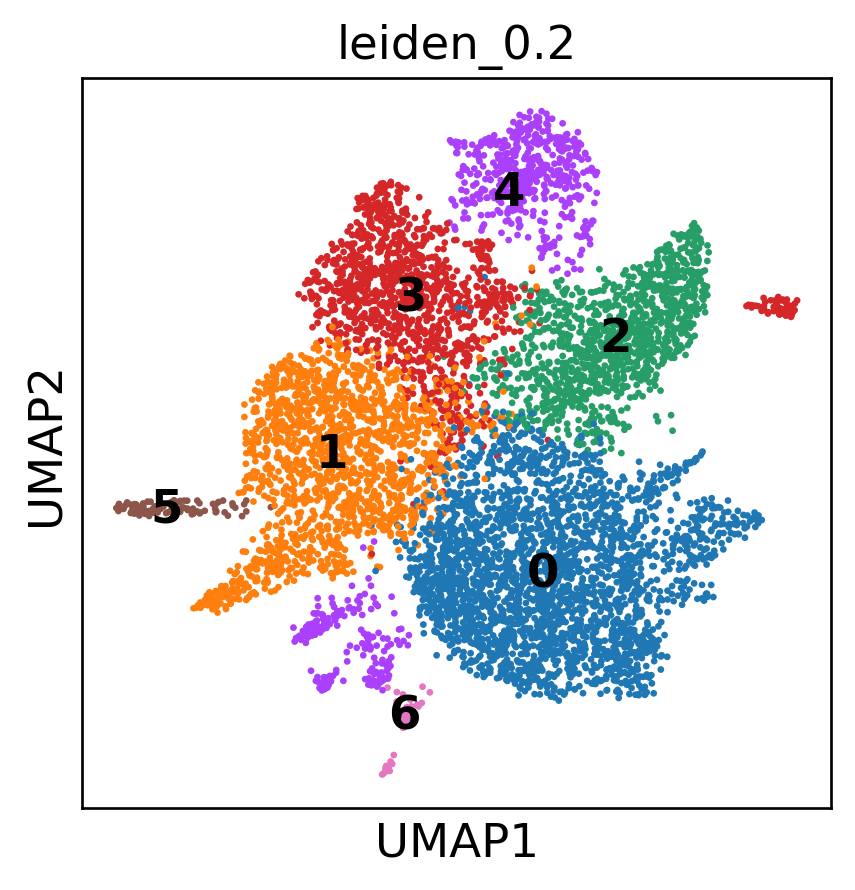

In [558]:
sc.pl.umap(adata_subcluster, color=[select_res], ncols=1,legend_loc='on data')

In [573]:
cl_major={
    "0": "Fibroblast",
    "1": "Fibroblast",
    "2": "Fibroblast",
    "3": "Fibroblast",
    "4": "Fibroblast",
    "5": "Fibroblast",
    "6": "Fibroblast",
    "7": "Fibroblast",
    "8": "Fibroblast",
    "9": "Fibroblast",
    "10": "Fibroblast",
}

In [574]:
adata_subcluster.obs["cl_major"] = adata_subcluster.obs[select_res].map(cl_major)

In [575]:
cl_minor={
    "0": "Fib-ANXA1",
    "1": "Fib-IGFBP7",
    "2": "Fib-COL23A1",
    "3": "Fib-ASAP1",
    "4": "Fib-ITPR2",
    "5": "Fib-BNC2",
    "6": "Fib-TCF4",
}

In [576]:
adata_subcluster.obs["cl_minor"] = adata_subcluster.obs[select_res].map(cl_minor)

... storing 'cl_major' as categorical


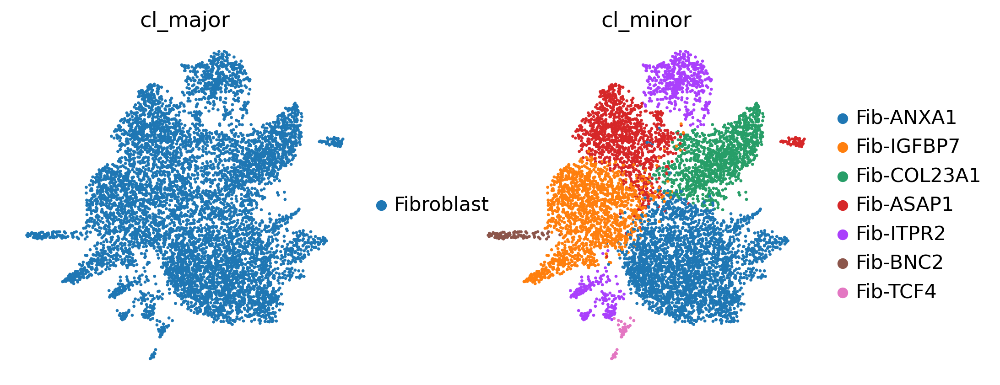

In [577]:
sc.pl.umap(adata_subcluster,color = ['cl_major','cl_minor'], frameon=False)

In [578]:
adata_subcluster.obs.to_csv(resdir +'/'+filtertype+'_'+select_cl+'_'+'sub_celltype.csv')

In [ ]:
sc.pl.umap(adata_keep,color = ['cl_minor'], frameon=False,ncols=1,legend_fontsize='xx-small',save='_major.png')

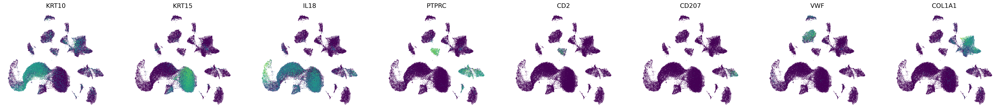

In [655]:
sc.pl.umap(adata_keep,color = 
    ['KRT10','KRT15','IL18',
    'PTPRC','CD2','CD207',
    'VWF','COL1A1',],
    frameon=False, ncols=8, colorbar_loc=None, save='_marker.png')

In [657]:
adata_qc = sc.read_h5ad(resdir+'/'+filtertype+'_qc.h5ad')

In [658]:
adata_anno_count = adata_qc[adata_qc.obs.index.isin(adata_keep.obs.index),:]

In [660]:
adata_anno_count.write_h5ad(resdir+'/'+filtertype+'_anno_count.h5ad')

In [112]:
adata = sc.read_h5ad(resdir+'/'+filtertype+'_anno.h5ad')

In [113]:
sc.pl.umap(adata,color = ['SampleType'], frameon=False, ncols=1, legend_fontsize='xx-small', show=False, save='_sampleType.png')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'SampleType'}, xlabel='UMAP1', ylabel='UMAP2'>

In [9]:
sc.pl.umap(adata,color = ['SampleID'], frameon=False, ncols=1, legend_fontsize='xx-small', show=False, save='_sampleID.png')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'SampleID'}, xlabel='UMAP1', ylabel='UMAP2'>

In [7]:
sc.pl.umap(adata,color = ['cl_major'], frameon=False, ncols=1, legend_fontsize='xx-small', show=False, save='_major.png')
#sc.pl.umap(adata,color = ['cl_minor'], frameon=False, ncols=1, legend_fontsize='xx-small', show=False, save='_minor.png')
#sc.pl.umap(adata,color = ['cl_subset'], frameon=False, ncols=1, legend_fontsize='xx-small', show=False, save='_subset.png')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Axes: title={'center': 'cl_subset'}, xlabel='UMAP1', ylabel='UMAP2'>

In [8]:
sc.pl.umap(adata,color = 
    ['KRT10','KRT15','IL18',
    'PTPRC','CD2','CD207',
    'VWF','COL1A1',],
    frameon=False, ncols=8, colorbar_loc=None, show = False, save='_marker.png')

[<Axes: title={'center': 'KRT10'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'KRT15'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'IL18'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'PTPRC'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'CD2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'CD207'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'VWF'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'COL1A1'}, xlabel='UMAP1', ylabel='UMAP2'>]

In [5]:
adata = sc.read_h5ad(resdir+'/'+filtertype+'_anno_count.h5ad')

In [5]:
subset_cl = 'Keratinocyte'

In [8]:
adata_subcluster = adata[adata.obs['cl_major'] == subset_cl,:]

In [9]:
adata_subcluster.write_h5ad(resdir+'/'+filtertype+'_'+subset_cl+'_count.h5ad')

In [10]:
adata_subcluster

View of AnnData object with n_obs × n_vars = 32986 × 28487
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'SampleID', 'SampleType', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'percent.rb', 'S.Score', 'G2M.Score', 'Phase', 'percent_rb', 'keep_leiden_0.8', 'keep_leiden_1.0', 'keep_leiden_1.2', 'GTEx_major', 'GTEx_minor', 'TS_compart', 'TS_subset', 'deve_minor', 'deve_subset', 'cl_major', 'cl_minor', 'cl_subset'
    var: 'n_cells'
    uns: 'SampleID_colors'

In [70]:
adata_subcluster = sc.read_h5ad('/home/zhepan/Project/MultiOmics/data/snRNA/Object/summary/Myeloid/myeloid_count.h5ad')

In [71]:
adata_subcluster.layers['count'] = adata_subcluster.X.copy()
sc.pp.normalize_total(adata_subcluster, target_sum=1e4)
sc.pp.log1p(adata_subcluster)
adata_subcluster.raw = adata_subcluster

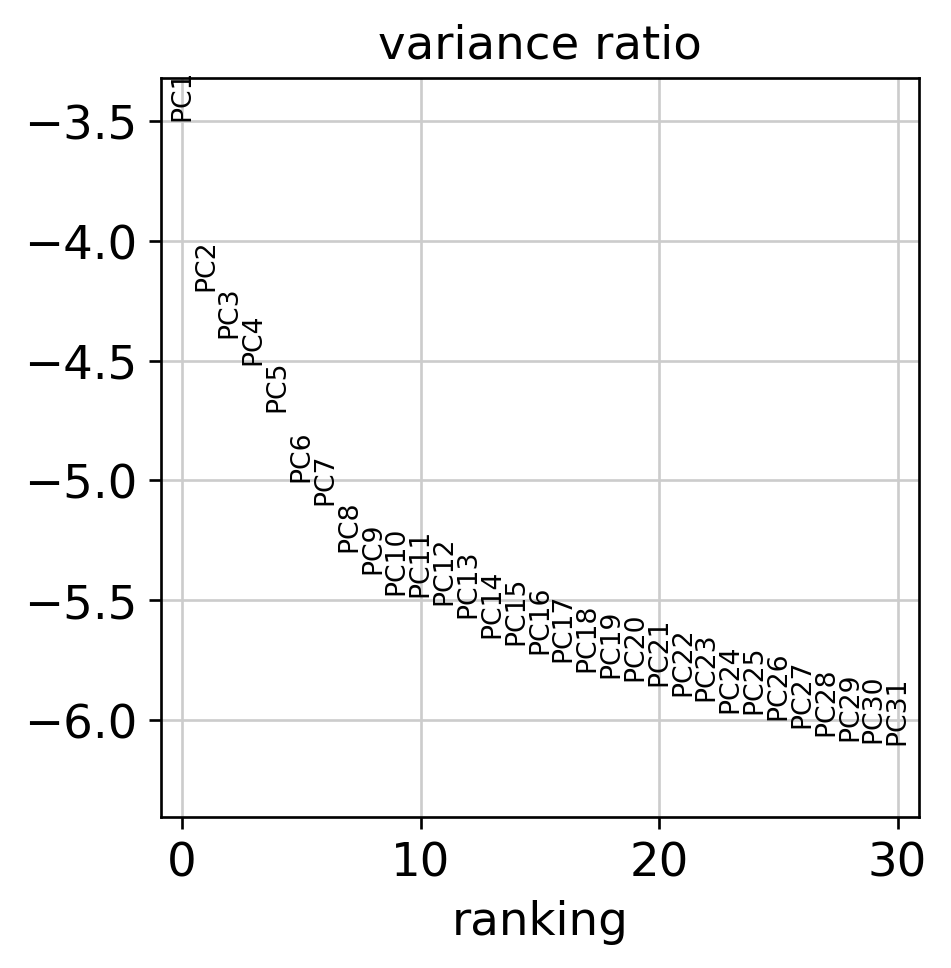

In [72]:
sc.pp.highly_variable_genes(
    adata_subcluster,layer = 'count',
    flavor="seurat_v3",
    n_top_genes=3000,
    subset=True,
    batch_key = 'SampleID', span = 0.5
)
sc.pp.scale(adata_subcluster)
sc.tl.pca(adata_subcluster, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_subcluster, log=True)

In [9]:
import scanpy.external as sce

In [73]:
sce.pp.harmony_integrate(adata_subcluster, ['SampleID'],max_iter_harmony=20)
sc.pp.neighbors(adata_subcluster, use_rep='X_pca_harmony',n_neighbors=40, n_pcs=30)
sc.tl.umap(adata_subcluster,min_dist=0.5)

2024-01-03 16:13:22,610 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-03 16:13:28,620 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-03 16:13:28,773 - harmonypy - INFO - Iteration 1 of 20
2024-01-03 16:13:32,131 - harmonypy - INFO - Iteration 2 of 20
2024-01-03 16:13:33,210 - harmonypy - INFO - Iteration 3 of 20
2024-01-03 16:13:36,503 - harmonypy - INFO - Iteration 4 of 20
2024-01-03 16:13:38,677 - harmonypy - INFO - Iteration 5 of 20
2024-01-03 16:13:40,973 - harmonypy - INFO - Iteration 6 of 20
2024-01-03 16:13:44,331 - harmonypy - INFO - Iteration 7 of 20
2024-01-03 16:13:45,797 - harmonypy - INFO - Iteration 8 of 20
2024-01-03 16:13:46,506 - harmonypy - INFO - Iteration 9 of 20
2024-01-03 16:13:48,827 - harmonypy - INFO - Iteration 10 of 20
2024-01-03 16:13:50,892 - harmonypy - INFO - Converged after 10 iterations


/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


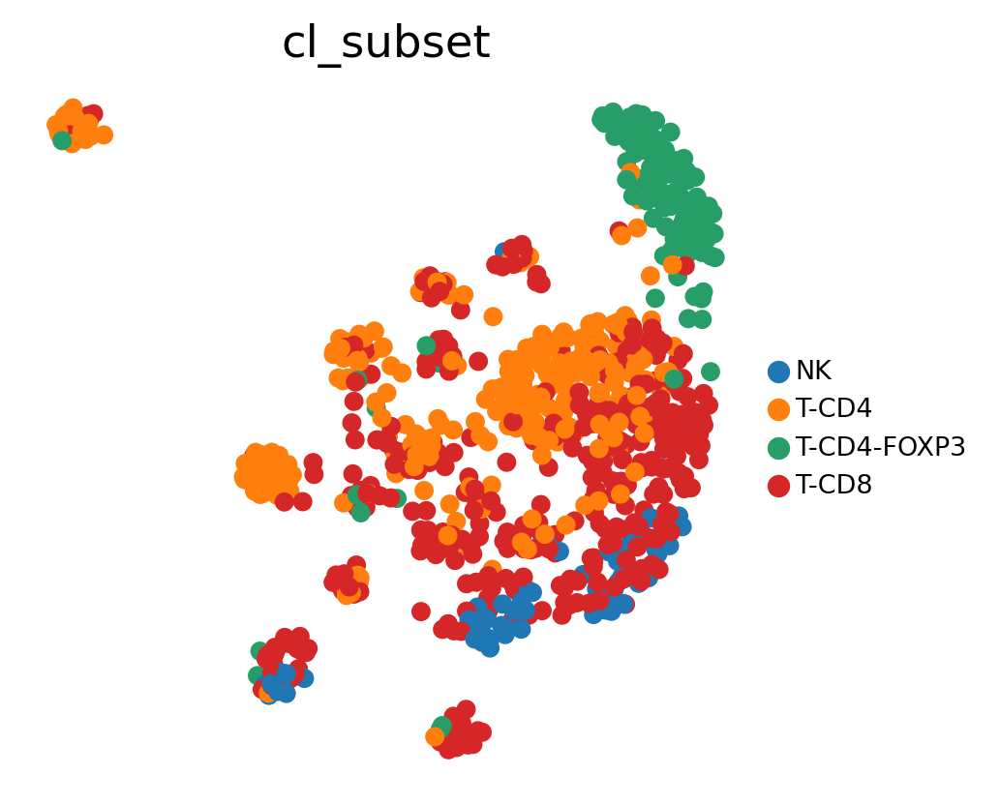

In [110]:
sc.pl.umap(adata_subcluster,color = ['cl_subset'], frameon=False, ncols=1, legend_fontsize='xx-small', show=True,save='_'+subset_cl+'_subset.png')

In [ ]:
adata_subcluster.write_h5ad(resdir+'/'+filtertype+'_'+subset_cl+'_subset.h5ad')

In [6]:
adata_subcluster = sc.read_h5ad(resdir+'/'+filtertype+'_'+subset_cl+'_subset.h5ad')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


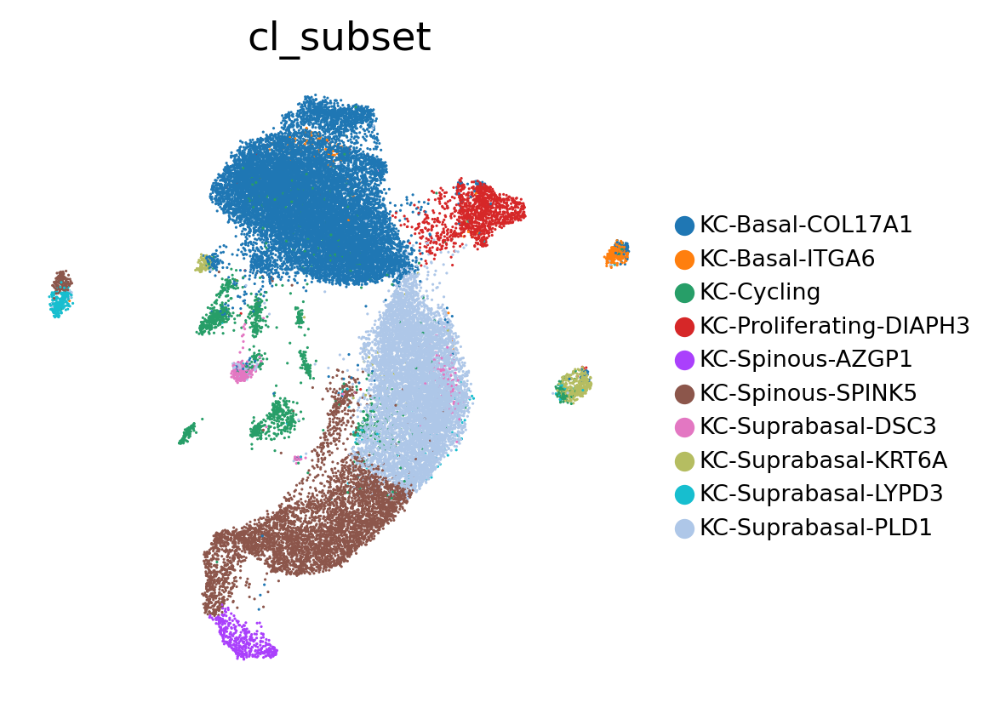

In [7]:
sc.pl.umap(adata_subcluster,color = ['cl_subset'], frameon=False, ncols=1, legend_fontsize='xx-small', show=True)

In [9]:
adata_subcluster.uns

{'SampleID_colors': array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b'],
       dtype=object),
 'hvg': {'flavor': 'seurat_v3'},
 'log1p': {},
 'neighbors': {'connectivities_key': 'connectivities',
  'distances_key': 'distances',
  'params': {'method': 'umap',
   'metric': 'euclidean',
   'n_neighbors': 40,
   'n_pcs': 30,
   'random_state': 0,
   'use_rep': 'X_pca_harmony'}},
 'pca': {'params': {'use_highly_variable': True, 'zero_center': True},
  'variance': array([80.22922  , 44.026215 , 24.717909 , 20.31247  , 13.060752 ,
         12.271169 , 10.137649 ,  7.478084 ,  6.4803348,  5.8328347,
          5.636578 ,  5.4898505,  5.394296 ,  5.0877295,  4.8458376,
          4.4772725,  4.1020393,  3.9219007,  3.6484792,  3.6173778,
          3.537144 ,  3.3184319,  3.2655723,  3.2033565,  3.1756234,
          3.1150186,  3.022169 ,  2.957729 ,  2.919197 ,  2.8877532,
          2.826039 ,  2.77258  ,  2.687585 ,  2.6513538,  2.636234 ,
          2.5823193,  2.5310247,  

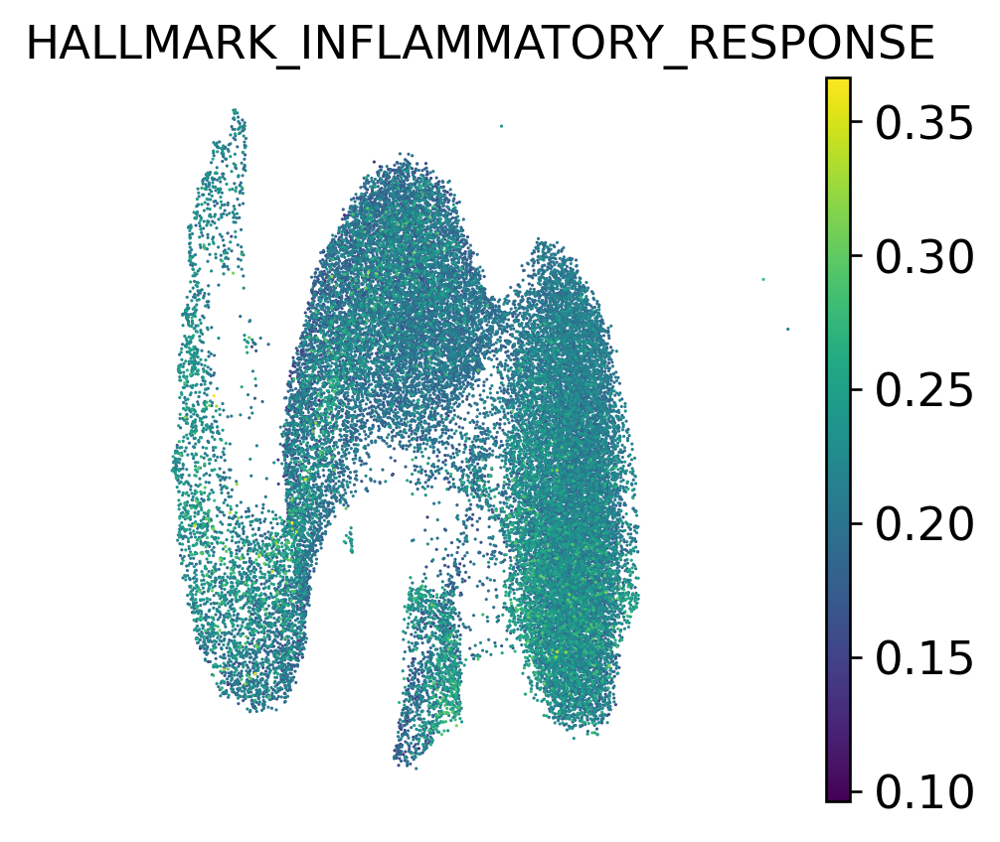

In [27]:
sc.pl.umap(adata_subcluster,color = ['HALLMARK_INFLAMMATORY_RESPONSE'], frameon=False, ncols=1, legend_fontsize='xx-small', show=True)

In [64]:
adata = sc.read_h5ad(resdir+'/'+filtertype+'_anno_count.h5ad')
adata.layers['count'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata

In [65]:
sc.tl.rank_genes_groups(adata, 'cl_minor', method='wilcoxon')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


In [66]:
sc.tl.filter_rank_genes_groups(adata, min_in_group_fraction=0.25)

In [68]:
marker_enrich = pd.DataFrame(adata.uns['rank_genes_groups_filtered']['names'])

In [69]:
marker_enrich.head(20)

,DC,Eccrine gland,Endo-Lymph,Endo-Vas,Fibroblast,KC-Basal,KC-Cycling,KC-Proliferating,KC-Spinous,KC-Suprabasal,LC,Macrophage,Mast cell,Melanocyte,NK,PVL,Schwann,T-CD4,T-CD8
0,CSF2RA,RUNX1,RHOJ,MCTP1,SNED1,COL17A1,LINC00511,DIAPH3,SPINK5,DMKN,PRKCB,RBM47,TNIK,DCT,PTPRC,CALD1,NRXN1,PTPRC,ARHGAP15
1,CD74,TRPS1,KALRN,ZNF385D,BICC1,NRG1,KIAA1217,CENPP,DMKN,COBL,SLC8A1,ZEB2,NTM,TRPM1,ARHGAP15,PRKG1,CADM2,ARHGAP15,PTPRC
2,PTPRC,SEMA3C,ST6GALNAC3,PTPRM,ANK2,LAMB4,DSG3,RP11-244M2.1,TMEM45A,NEBL,ALOX5,PTPRC,RAB27B,FMN1,SKAP1,RBMS3,NRXN3,SKAP1,SKAP1
3,HLA-DRA,PNLIPRP3,PKHD1L1,PLCB1,RBMS3,DST,TIAM1,ARHGAP11B,HOPX,DSP,RTN1,IQGAP2,HPGD,INPP4B,PIP4K2A,NaN,CDH19,FAM129A,PARP8
4,SLC8A1,ESRRG,AC007319.1,EMCN,DCLK1,P3H2,ABCA12,ASPM,RP11-35J10.5,PLD1,ELMO1,ELMO1,SYTL3,TYR,ANKRD44,COL4A2,XKR4,ANKRD44,ANKRD44
5,ETV6,GPC6,ZFPM2,SNTG2,SLIT3,SOX6,NaN,NaN,SCEL,MPP7,CDH20,ARHGAP26,HDC,TYRP1,FYN,CACNA1C,DOCK5,ITK,IQGAP2
6,HLA-DRB1,TFCP2L1,PPFIBP1,SPARCL1,LAMA2,TP63,BTBD11,NaN,ABCA12,DSC3,DOCK4,RBPJ,ELMO1,OCA2,PARP8,RBPMS,STARD13,RP11-624L4.1,FAM129A
7,SIPA1L1,ATP1B3,TFPI,LDB2,ROBO2,KRT15,MAST4,ATAD2,GAN,KRT10,RP11-624C23.1,RAB31,IL18R1,PTPRM,SYTL3,TPM1,ADGRB3,CTB-4E7.1,FYN
8,ELMO1,PRICKLE1,MMRN1,ERG,COL1A2,LAMA3,CMIP,BRIP1,ATP10B,ROBO1,ENTPD1-AS1,SIPA1L1,KIT,MYO5A,PITPNC1,SYNPO2,PPP2R2B,CHST11,SYTL3
9,HLA-DQA1,ZBTB7C,LDB2,ELMO1,DLC1,PTPN14,MAP7,CIT,SLC9C1,DSG1,ENTPD1,LDLRAD4,SLC24A3,LSAMP,CBLB,PRRX1,SORCS1,IQGAP2,CD96


In [70]:
adata.obs.cl_minor.value_counts()

cl_minor
KC-Basal            15543
KC-Suprabasal        9355
Fibroblast           7317
KC-Spinous           5164
Endo-Vas             2866
Melanocyte           2459
KC-Cycling           1654
PVL                  1636
Macrophage           1462
KC-Proliferating     1270
Eccrine gland        1051
LC                    808
Endo-Lymph            776
DC                    719
Mast cell             432
T-CD4                 405
T-CD8                 371
Schwann               141
NK                     68
Name: count, dtype: int64

In [78]:
marker_genes_dict = {
    "KC-Basal" : ["KRT14", "KRT5", "COL17A1"],
    "KC-Suprabasal" : ["KRT10","KRT1"],
    "KC-Spinous" : ["SPINK5"],
    "KC-Proliferating" : ["DIAPH3", "CENPP", "ASPM"],
    "KC-Cycling" : ["KIAA1217"],
    "T" : ["PTPRC", "IL7R","CD2"],
    "NK" : ["CD96"],
    "Macrophage" : ["ZEB2","SLC8A1"],
    "DC" : ["CD74", "ETV6", "CSF2RA"],
    "LC" : ["PRKCB"],
    "Mast cell" : ["TNIK", "NTM"],
    "Melanocyte" : ["TRPM1", "FMN1"], # Melanocyte markers
    "Endo-Vas" : ["VWF", "PECAM1", "MCTP1"], 
    "Endo-Lymph" : ["PKHD1L1", "KALRN"], 
    "PVL" : ["ACTA2"],
    "Fibroblasts" : ["COL1A1", "COL3A1"], 
    "Schwann" : ["NRXN1", "CADM2"],
}


/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(

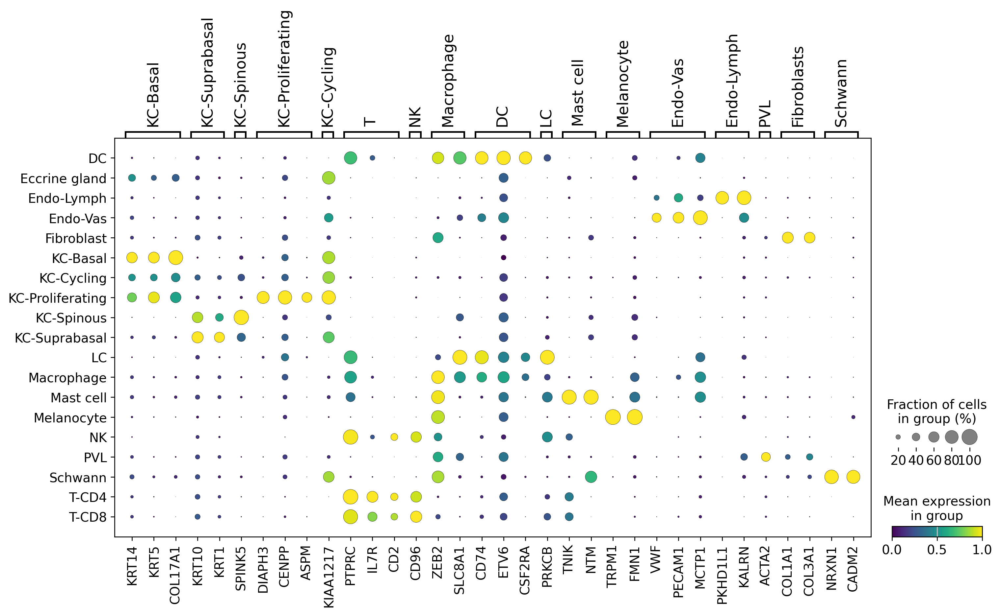

In [80]:
sc.pl.dotplot (adata, marker_genes_dict, standard_scale='var', groupby='cl_minor', dendrogram=False, use_raw=True, cmap='viridis')

In [8]:
adata_subcluster = sc.read_h5ad(resdir+'/'+filtertype+'_keratinocyte_subset.h5ad')

In [9]:
enrich_res = pd.read_table(resdir+'/'+'ssgsea_kera.txt',sep = '\t',index_col=0)
adata_subcluster.obs = adata_subcluster.obs.join(enrich_res)

In [16]:
adata_subcluster.obs.columns.tolist()

['orig.ident',
 'nCount_RNA',
 'nFeature_RNA',
 'PatientID',
 'SampleID',
 'SampleType',
 'SampleDate',
 'Kit',
 'scDblFinder.score',
 'scDblFinder.class',
 'percent_mt',
 'percent_hb',
 'percent.rb',
 'S.Score',
 'G2M.Score',
 'Phase',
 'percent_rb',
 'keep_leiden_0.8',
 'keep_leiden_1.0',
 'keep_leiden_1.2',
 'GTEx_major',
 'GTEx_minor',
 'TS_compart',
 'TS_subset',
 'deve_minor',
 'deve_subset',
 'cl_major',
 'cl_minor',
 'cl_subset',
 'HALLMARK_ADIPOGENESIS',
 'HALLMARK_ALLOGRAFT_REJECTION',
 'HALLMARK_ANDROGEN_RESPONSE',
 'HALLMARK_ANGIOGENESIS',
 'HALLMARK_APICAL_JUNCTION',
 'HALLMARK_APICAL_SURFACE',
 'HALLMARK_APOPTOSIS',
 'HALLMARK_BILE_ACID_METABOLISM',
 'HALLMARK_CHOLESTEROL_HOMEOSTASIS',
 'HALLMARK_COAGULATION',
 'HALLMARK_COMPLEMENT',
 'HALLMARK_DNA_REPAIR',
 'HALLMARK_E2F_TARGETS',
 'HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION',
 'HALLMARK_ESTROGEN_RESPONSE_EARLY',
 'HALLMARK_ESTROGEN_RESPONSE_LATE',
 'HALLMARK_FATTY_ACID_METABOLISM',
 'HALLMARK_G2M_CHECKPOINT',
 'HALLMARK

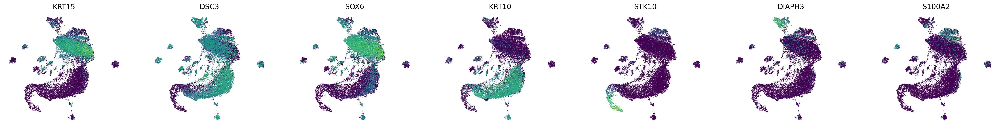

In [28]:
sc.pl.umap(adata_subcluster,color = [ "KRT15",'DSC3','SOX6','KRT10','STK10','DIAPH3','S100A2'],frameon= False, ncols = 8,  colorbar_loc=None,use_raw = True,save='_kera_marker.png')

In [49]:
select_score = 'HALLMARK_TGF_BETA_SIGNALING'

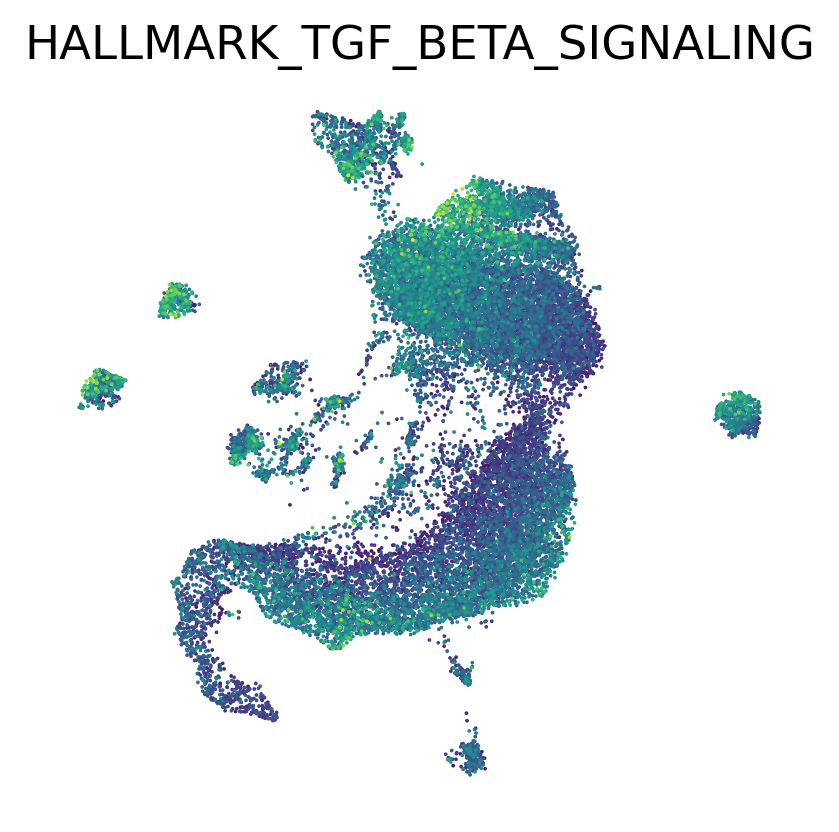

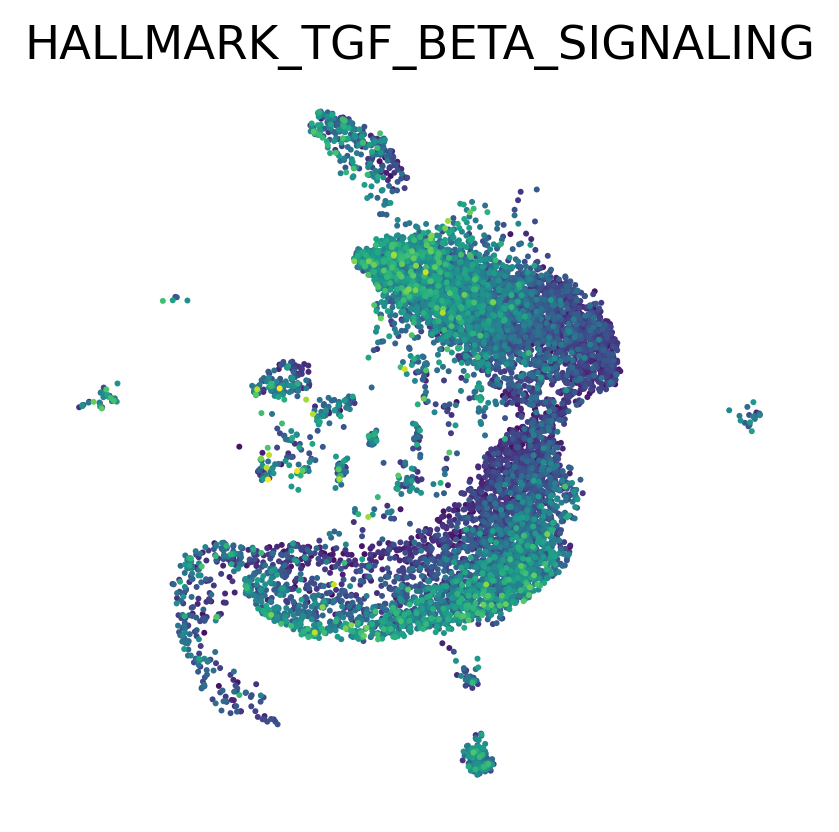

In [50]:
sc.pl.umap(adata_subcluster[adata_subcluster.obs['SampleType'] == 'H',:],color = [select_score], frameon=False, ncols=1, legend_fontsize='xx-small', colorbar_loc=None)
sc.pl.umap(adata_subcluster[adata_subcluster.obs['SampleType'] == 'N',:],color = [select_score], frameon=False, ncols=1, legend_fontsize='xx-small', colorbar_loc=None)

In [38]:
adata = sc.read_h5ad('/home/zhepan/Project/MultiOmics/data/snRNA/Object/summary/Myeloid/myeloid_.h5ad')
anno = pd.read_table('/home/zhepan/Project/MultiOmics/data/snRNA/Object/summary/annotation/myeloid_cluster.tsv',sep = '\t',index_col=0)

In [7]:
adata_sub = adata[adata.obs['cl_comp'] == 'Myeloid']

In [8]:
adata_sub

View of AnnData object with n_obs × n_vars = 2484 × 29628
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'scDblFinder.score', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'cellid', 'cl_major', 'cl_minor', 'pseudo_pt', 'pseudo_tp', 'pseudo_sample', 'cl_comp'
    var: 'name'

In [10]:
adata_sub.layers['count'] = adata_sub.X.copy()
sc.pp.normalize_total(adata_sub, target_sum=1e4)
sc.pp.log1p(adata_sub)
adata_sub.raw = adata_sub

/tmp/ipykernel_1227521/74866606.py:1: ImplicitModificationWarning: Setting element `.layers['count']` of view, initializing view as actual.
  adata_sub.layers['count'] = adata_sub.X.copy()


In [12]:
sc.pp.highly_variable_genes(adata_sub)
sc.pp.scale(adata_sub)
sc.tl.pca(adata_sub, svd_solver='arpack')

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:220: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


In [13]:
sce.pp.harmony_integrate(adata_sub, ['SampleID'],max_iter_harmony=20)
sc.pp.neighbors(adata_sub, use_rep='X_pca_harmony',n_neighbors=40, n_pcs=30)
sc.tl.umap(adata_sub,min_dist=0.5)

2024-02-06 22:08:09,807 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-02-06 22:08:26,612 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-02-06 22:08:26,715 - harmonypy - INFO - Iteration 1 of 20
2024-02-06 22:08:29,868 - harmonypy - INFO - Iteration 2 of 20
2024-02-06 22:08:33,182 - harmonypy - INFO - Converged after 2 iterations


/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


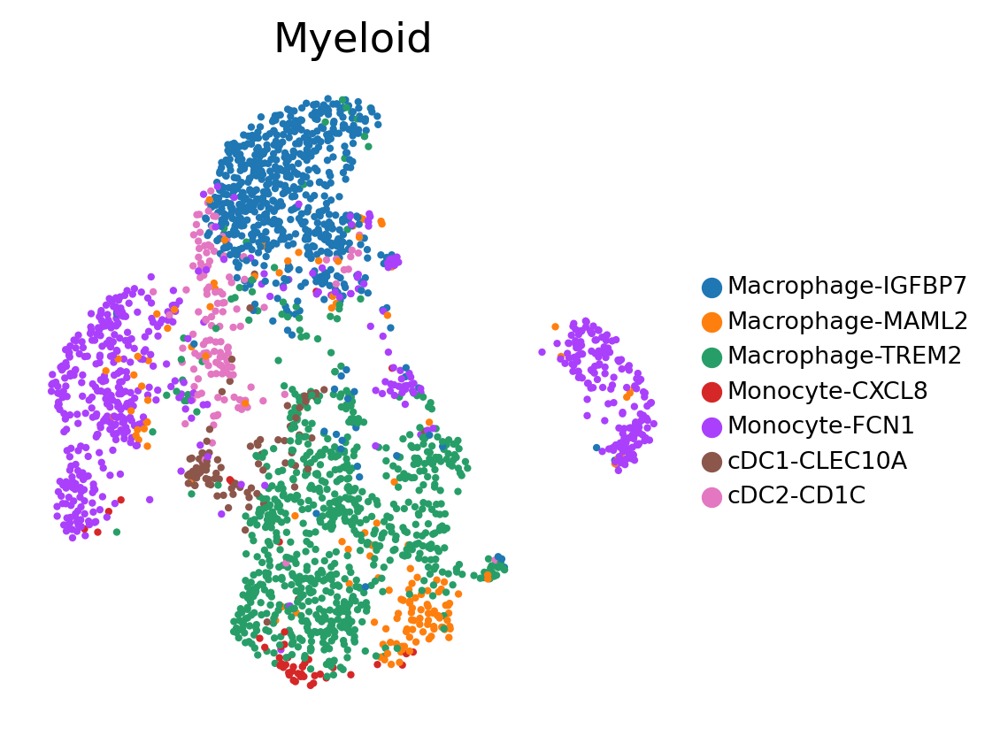

In [21]:
sc.pl.umap(adata_sub,color = ['cl_minor'], title = 'Myeloid', frameon=False, ncols=1,size = 25, legend_fontsize='xx-small',save = 'myeloid.pdf')

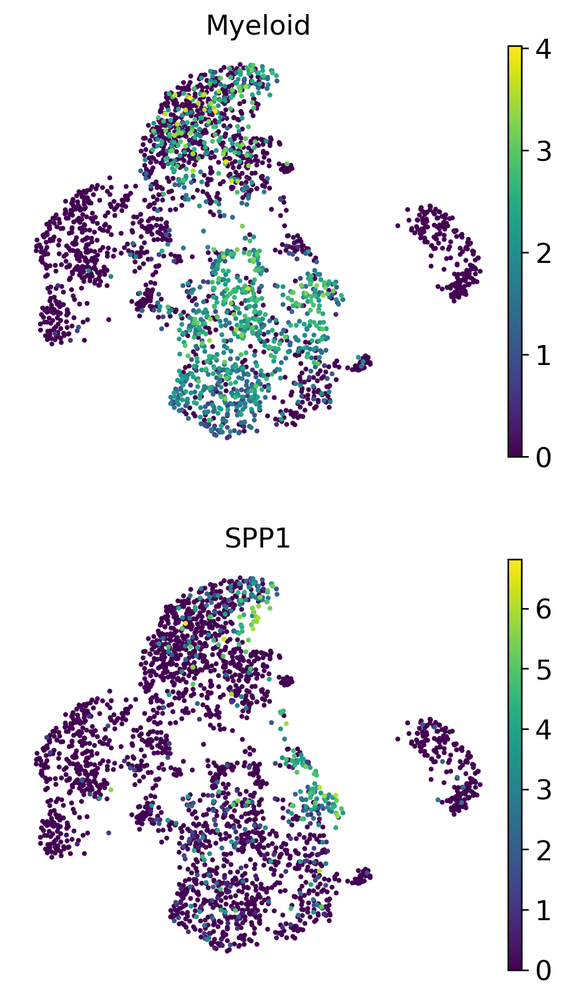

In [22]:
sc.pl.umap(adata_sub,color = ['TREM2','SPP1'], title = 'Myeloid', frameon=False, ncols=1,size = 25, legend_fontsize='xx-small')

In [39]:
adata.obs = anno

In [43]:
adata

AnnData object with n_obs × n_vars = 1957 × 3000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'PatientID', 'NeoChemoRes', 'NeoRadRes', 'SampleID', 'SampleTimepoint', 'SampleMethod', 'SampleDate', 'Kit', 'scDblFinder.score', 'scDblFinder.class', 'percent_mt', 'percent_hb', 'S.Score', 'G2M.Score', 'Phase', 'batch', 're_leiden_0.2', 're_leiden_0.4', 're_leiden_0.6', 'BCatlas_major.majority_voting', 'BCatlas_minor.majority_voting', 'BCatlas_subset.majority_voting', 'HBCA_broad_cell_type.majority_voting', 'HBCA_cell_type.majority_voting', 'HBCA_author_cell_type.majority_voting', 'C_scANVI', 'manual_celltype_annotation', 'cor_bar.1', 'harmony_leiden_0.2', 'harmony_leiden_0.4', 'harmony_leiden_0.6', 'harmony_leiden_0.8', 'harmony_leiden_0.3', 'harmony_leiden_0.5', 'myeloid_major', 'Mcrophage_leiden', 'DC_leiden', 'Macrophage_leiden', 'Monocyte_leiden', 'Macorphage_minor', 'Myeloid_minor', 'myeloid_minor_order'
    var: 'name-0', 'name-1', 'name-2', 'highly_variable', 'highly_variable_

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

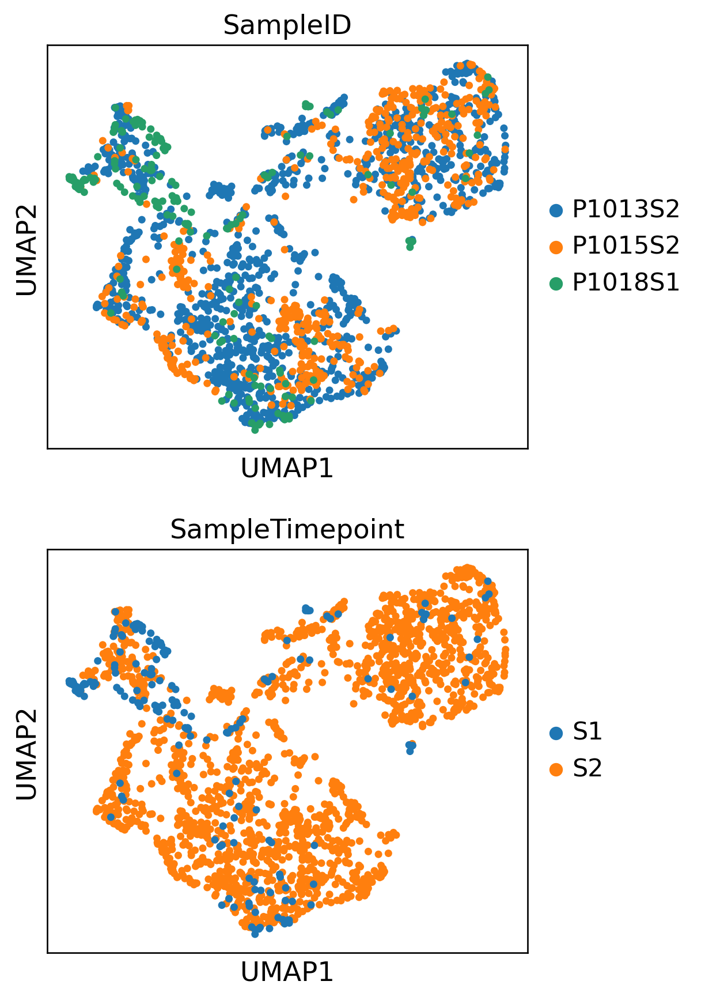

In [40]:
sc.pl.umap(adata, color = ['SampleID','SampleTimepoint'], ncols = 1)

/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/zhepan/miniconda3/envs/scRNA/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


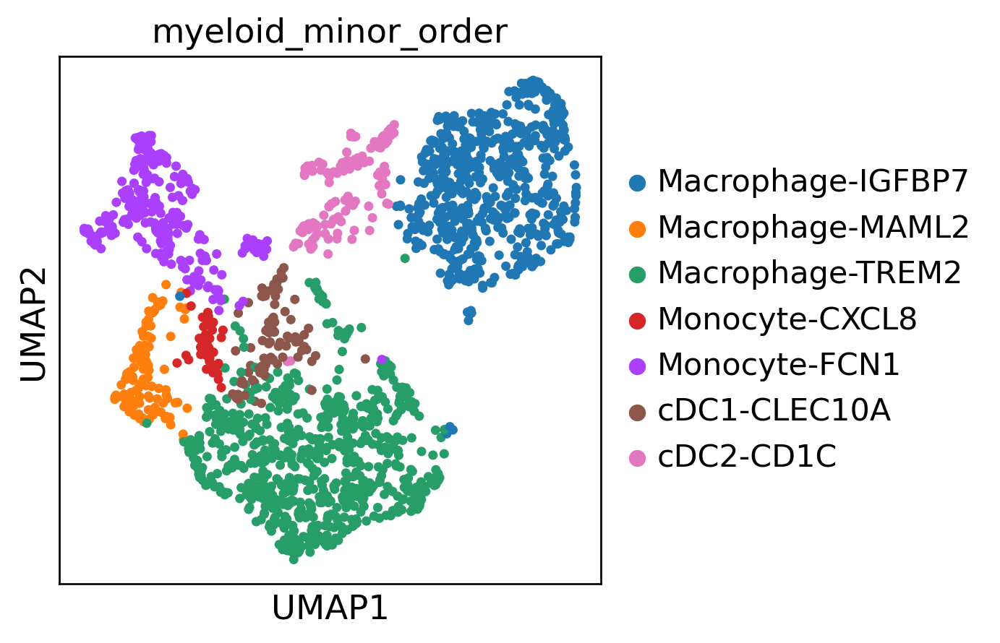

In [44]:
sc.pl.umap(adata, color = ['myeloid_minor_order'], ncols = 1)

In [47]:
adata.obs.to_csv(resdir+'/myeloid_celltype.csv')

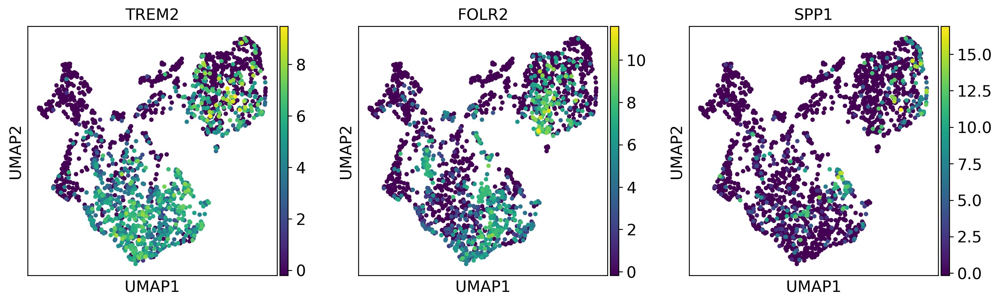

In [51]:
sc.pl.umap(adata, color = ['TREM2','FOLR2','SPP1'])